In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import scipy,os
from scipy.optimize import minimize
from typing import Tuple, List, Optional
import math

Circle Fitting Examples

1. Perfect Circle (3 points)
   Center: (-0.000, -0.000)
   Radius: 1.000
   Max Error: 0.000000

2. Noisy Data (Least Squares)

   Algebraic Least Squares:
   Center: (2.015, 2.966)
   Radius: 2.546
   RMSE: 0.085
   Max Error: 0.158

   Geometric Fit:
   Center: (2.012, 2.969)
   Radius: 2.545
   RMSE: 0.085
   Max Error: 0.153

3. Creating visualization...


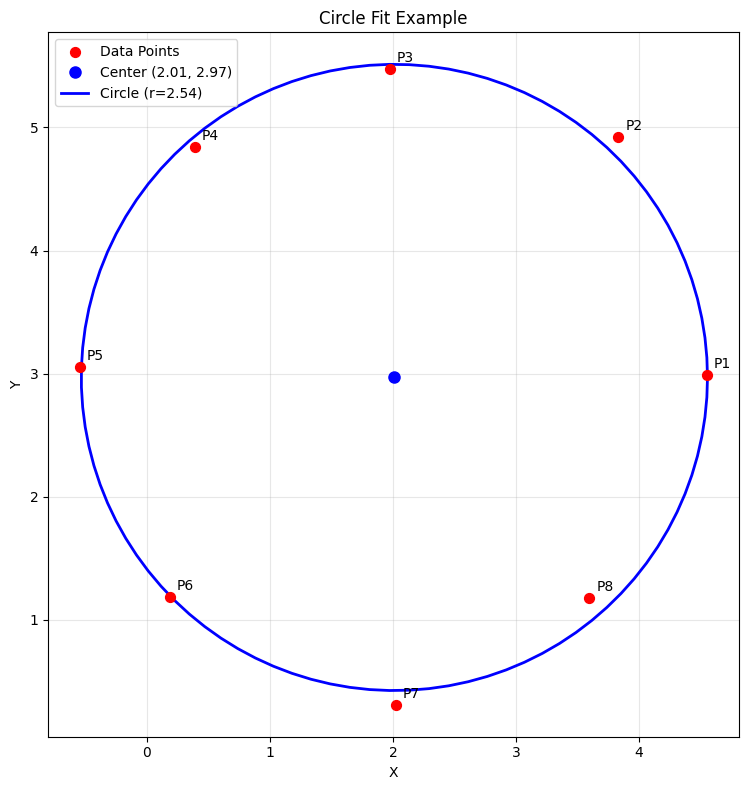

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from typing import Tuple, List, Optional
import math

class CircleFitter:
    """
    A class for fitting circles to sets of points using various methods.
    """
    
    @staticmethod
    def three_point_circle(p1: Tuple[float, float], 
                          p2: Tuple[float, float], 
                          p3: Tuple[float, float]) -> Optional[Tuple[Tuple[float, float], float]]:
        """
        Find the exact circle passing through three points.
        
        Args:
            p1, p2, p3: Tuples of (x, y) coordinates
            
        Returns:
            ((center_x, center_y), radius) or None if points are collinear
        """
        x1, y1 = p1
        x2, y2 = p2
        x3, y3 = p3
        
        # Calculate the determinant to check if points are collinear
        det = 2 * (x1 * (y2 - y3) + x2 * (y3 - y1) + x3 * (y1 - y2))
        
        if abs(det) < 1e-10:
            return None  # Points are collinear
        
        # Calculate center coordinates
        ux = ((x1**2 + y1**2) * (y2 - y3) + 
              (x2**2 + y2**2) * (y3 - y1) + 
              (x3**2 + y3**2) * (y1 - y2)) / det
              
        uy = ((x1**2 + y1**2) * (x3 - x2) + 
              (x2**2 + y2**2) * (x1 - x3) + 
              (x3**2 + y3**2) * (x2 - x1)) / det
        
        # Calculate radius
        radius = math.sqrt((ux - x1)**2 + (uy - y1)**2)
        
        return ((ux, uy), radius)
    
    @staticmethod
    def least_squares_circle(points: List[Tuple[float, float]]) -> Tuple[Tuple[float, float], float]:
        """
        Find the best-fit circle using least squares method (algebraic approach).
        
        Args:
            points: List of (x, y) coordinate tuples
            
        Returns:
            ((center_x, center_y), radius)
        """
        points = np.array(points)
        n = len(points)
        
        if n < 3:
            raise ValueError("Need at least 3 points")
        
        # Set up the system of equations: Ax = b
        # For circle equation: x² + y² + Dx + Ey + F = 0
        # We solve for D, E, F, then convert to center-radius form
        
        A = np.zeros((n, 3))
        b = np.zeros(n)
        
        for i, (x, y) in enumerate(points):
            A[i] = [x, y, 1]
            b[i] = -(x**2 + y**2)
        
        # Solve the least squares problem
        coeffs, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
        D, E, F = coeffs
        
        # Convert to center-radius form
        center_x = -D / 2
        center_y = -E / 2
        radius = math.sqrt(D**2 + E**2 - 4*F) / 2
        
        return ((center_x, center_y), radius)
    
    @staticmethod
    def geometric_circle_fit(points: List[Tuple[float, float]], 
                           initial_guess: Optional[Tuple[float, float, float]] = None) -> Tuple[Tuple[float, float], float]:
        """
        Find the best-fit circle using geometric distance minimization (Levenberg-Marquardt style).
        This minimizes the sum of squared distances from points to the circle.
        
        Args:
            points: List of (x, y) coordinate tuples
            initial_guess: Optional (center_x, center_y, radius) starting point
            
        Returns:
            ((center_x, center_y), radius)
        """
        points = np.array(points)
        
        if initial_guess is None:
            # Use centroid as initial center guess
            center_x = np.mean(points[:, 0])
            center_y = np.mean(points[:, 1])
            # Initial radius as average distance from centroid
            distances = np.sqrt((points[:, 0] - center_x)**2 + (points[:, 1] - center_y)**2)
            radius = np.mean(distances)
            initial_guess = (center_x, center_y, radius)
        
        def objective(params):
            cx, cy, r = params
            distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
            return np.sum((distances - r)**2)
        
        # Optimize
        result = minimize(objective, initial_guess, method='Nelder-Mead')
        
        if not result.success:
            print("Warning: Optimization may not have converged")
        
        cx, cy, r = result.x
        return ((cx, cy), abs(r))
    
    @staticmethod
    def calculate_fit_quality(points: List[Tuple[float, float]], 
                            center: Tuple[float, float], 
                            radius: float) -> dict:
        """
        Calculate various metrics to assess the quality of the circle fit.
        
        Args:
            points: List of (x, y) coordinate tuples
            center: (center_x, center_y) tuple
            radius: Circle radius
            
        Returns:
            Dictionary with fit quality metrics
        """
        points = np.array(points)
        cx, cy = center
        
        # Calculate distances from each point to the center
        distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
        
        # Calculate errors (deviation from ideal radius)
        errors = np.abs(distances - radius)
        
        return {
            'max_error': np.max(errors),
            'mean_error': np.mean(errors),
            'std_error': np.std(errors),
            'rmse': np.sqrt(np.mean(errors**2)),
            'distances': distances.tolist(),
            'errors': errors.tolist()
        }
    
    @staticmethod
    def plot_circle_fit(points: List[Tuple[float, float]], 
                       center: Tuple[float, float], 
                       radius: float,
                       title: str = "Circle Fit"):
        """
        Plot the points and fitted circle.
        
        Args:
            points: List of (x, y) coordinate tuples
            center: (center_x, center_y) tuple
            radius: Circle radius
            title: Plot title
        """
        points = np.array(points)
        cx, cy = center
        
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
        
        # Plot points
        ax.scatter(points[:, 0], points[:, 1], color='red', s=50, zorder=5, label='Data Points')
        
        # Plot center
        ax.plot(cx, cy, 'bo', markersize=8, label=f'Center ({cx:.2f}, {cy:.2f})')
        
        # Plot circle
        theta = np.linspace(0, 2*np.pi, 100)
        circle_x = cx + radius * np.cos(theta)
        circle_y = cy + radius * np.sin(theta)
        ax.plot(circle_x, circle_y, 'b-', linewidth=2, label=f'Circle (r={radius:.2f})')
        
        # Add point labels
        for i, (x, y) in enumerate(points):
            ax.annotate(f'P{i+1}', (x, y), xytext=(5, 5), textcoords='offset points')
        
        ax.set_aspect('equal')
        ax.grid(True, alpha=0.3)
        ax.legend()
        ax.set_title(title)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        
        plt.tight_layout()
        plt.show()


def example_usage():
    """
    Demonstrate the different circle fitting methods with example data.
    """
    print("Circle Fitting Examples")
    print("=" * 50)
    
    # Example 1: Perfect circle points
    print("\n1. Perfect Circle (3 points)")
    perfect_points = [(0, 1), (1, 0), (0, -1)]
    
    result = CircleFitter.three_point_circle(*perfect_points)
    if result:
        center, radius = result
        print(f"   Center: ({center[0]:.3f}, {center[1]:.3f})")
        print(f"   Radius: {radius:.3f}")
        
        quality = CircleFitter.calculate_fit_quality(perfect_points, center, radius)
        print(f"   Max Error: {quality['max_error']:.6f}")
    
    # Example 2: Noisy data with least squares
    print("\n2. Noisy Data (Least Squares)")
    np.random.seed(42)  # For reproducible results
    true_center = (2, 3)
    true_radius = 2.5
    n_points = 8
    
    # Generate points on circle with noise
    angles = np.linspace(0, 2*np.pi, n_points, endpoint=False)
    noisy_points = []
    for angle in angles:
        x = true_center[0] + true_radius * np.cos(angle) + np.random.normal(0, 0.1)
        y = true_center[1] + true_radius * np.sin(angle) + np.random.normal(0, 0.1)
        noisy_points.append((x, y))
    
    # Try different methods
    methods = [
        ("Algebraic Least Squares", CircleFitter.least_squares_circle),
        ("Geometric Fit", CircleFitter.geometric_circle_fit)
    ]
    
    for method_name, method_func in methods:
        center, radius = method_func(noisy_points)
        quality = CircleFitter.calculate_fit_quality(noisy_points, center, radius)
        
        print(f"\n   {method_name}:")
        print(f"   Center: ({center[0]:.3f}, {center[1]:.3f})")
        print(f"   Radius: {radius:.3f}")
        print(f"   RMSE: {quality['rmse']:.3f}")
        print(f"   Max Error: {quality['max_error']:.3f}")
    
    # Example 3: Visualization
    print("\n3. Creating visualization...")
    center, radius = CircleFitter.geometric_circle_fit(noisy_points)
    CircleFitter.plot_circle_fit(noisy_points, center, radius, "Circle Fit Example")


def interactive_example():
    """
    Interactive example where you can input your own points.
    """
    print("\nInteractive Circle Fitting")
    print("=" * 30)
    print("Enter points as 'x,y' (press Enter with empty input to finish)")
    
    points = []
    while True:
        try:
            user_input = input(f"Point {len(points)+1}: ").strip()
            if not user_input:
                break
                
            x, y = map(float, user_input.split(','))
            points.append((x, y))
            print(f"  Added point: ({x}, {y})")
            
        except ValueError:
            print("  Invalid input. Please use format 'x,y' (e.g., '1.5,2.3')")
        except KeyboardInterrupt:
            print("\n  Cancelled.")
            return
    
    if len(points) < 3:
        print("Need at least 3 points for circle fitting.")
        return
    
    print(f"\nFitting circle to {len(points)} points...")
    
    # Use geometric fitting for best results
    try:
        center, radius = CircleFitter.geometric_circle_fit(points)
        quality = CircleFitter.calculate_fit_quality(points, center, radius)
        
        print(f"\nResults:")
        print(f"Center: ({center[0]:.3f}, {center[1]:.3f})")
        print(f"Radius: {radius:.3f}")
        print(f"RMSE: {quality['rmse']:.3f}")
        print(f"Max Error: {quality['max_error']:.3f}")
        
        # Optionally create plot
        try:
            CircleFitter.plot_circle_fit(points, center, radius, "Your Circle Fit")
        except:
            print("(Plotting not available in this environment)")
            
    except Exception as e:
        print(f"Error fitting circle: {e}")


if __name__ == "__main__":
    # Run example
    example_usage()
    
    # Uncomment the line below for interactive mode
    # interactive_example()

Current working directory: c:\Users\Jason.Bane\Documents\Nautilus\DOE_stage\code_trials
does image exist? False
Loading image: Image00018.BMP


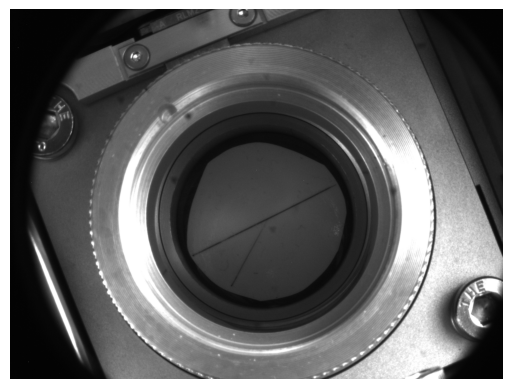

In [4]:
# Load an image using OpenCV

image_name = 'Image00018.BMP'
#image_name = '20250910_155525.jpg'
print("Current working directory:", os.getcwd())
print("does image exist?", os.path.exists(image_name))
print(f"Loading image: {image_name}")

image_name = 'images/Image00000.BMP'
image = cv2.imread(image_name)

# Convert the image to RGB (OpenCV uses BGR by default)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the image using Matplotlib
plt.imshow(image_rgb)
plt.axis('off')  # Hide the axis
plt.show()

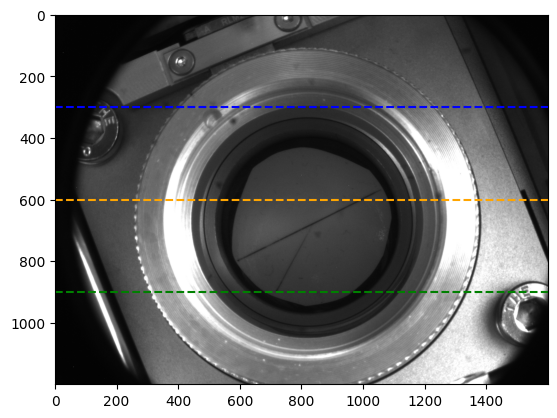

In [94]:
#grey scale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.imshow(gray_image, cmap='gray')

#add a line at 25% height
height, width = gray_image.shape
plt.axhline(y=int(height*0.25), color='b', linestyle='--', label='25% height')
plt.axhline(y=int(height*0.5), color='orange', linestyle='--', label='50% height')
plt.axhline(y=int(height*0.75), color='green', linestyle='--', label='75% height')


## Grab horizontal peaks

Image dimensions: 1600x1200
Cross section at 35% height, with 2 peaks found
Peaks at [211 699] with heights [231. 246.]
Prominences: [ 80. 231.]
Cross section at 38% height, with 2 peaks found
Peaks at [647 958] with heights [245. 246.]
Prominences: [ 51. 246.]
Cross section at 40% height, with 2 peaks found
Peaks at [ 616 1004] with heights [244. 246.]
Prominences: [ 54. 246.]
Cross section at 43% height, with 2 peaks found
Peaks at [ 618 1053] with heights [245. 245.]
Prominences: [245. 245.]
Cross section at 45% height, with 2 peaks found
Peaks at [ 587 1075] with heights [242. 246.]
Prominences: [ 58. 246.]
Cross section at 48% height, with 4 peaks found
Peaks at [ 475  595 1088 1521] with heights [205. 242. 245. 246.]
Prominences: [ 51.  62. 245.  70.]
Cross section at 50% height, with 3 peaks found
Peaks at [ 552 1097 1535] with heights [242. 245. 245.]
Prominences: [ 63. 245.  65.]
Cross section at 53% height, with 3 peaks found
Peaks at [ 566 1104 1545] with heights [243. 245. 

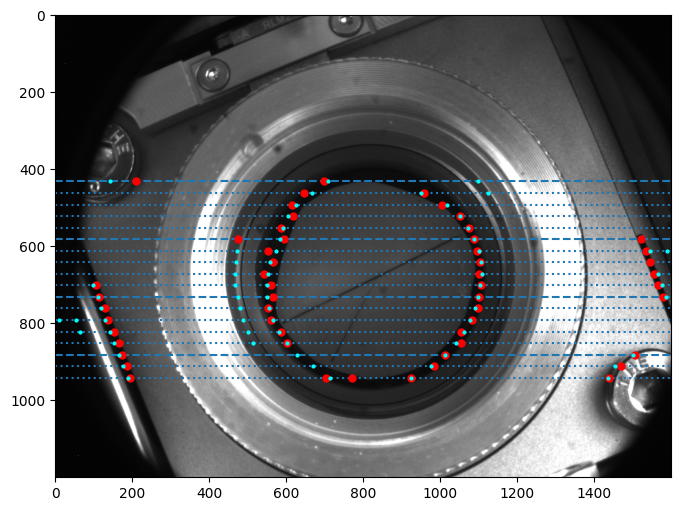

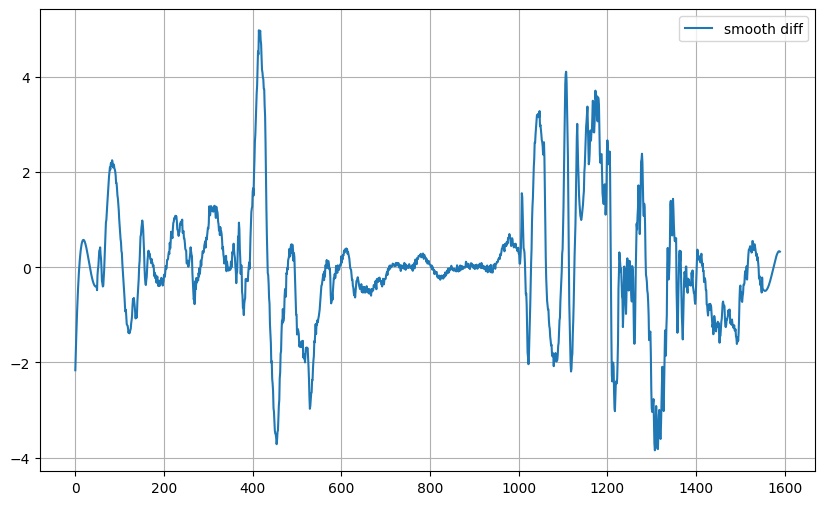

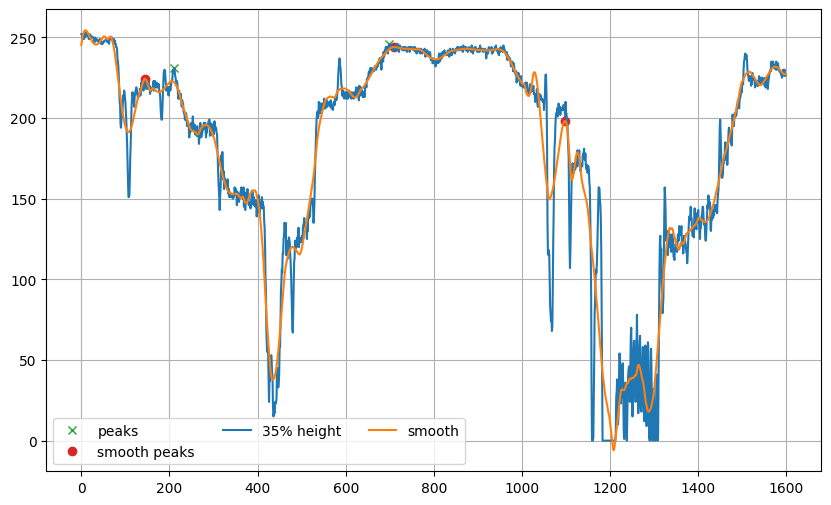

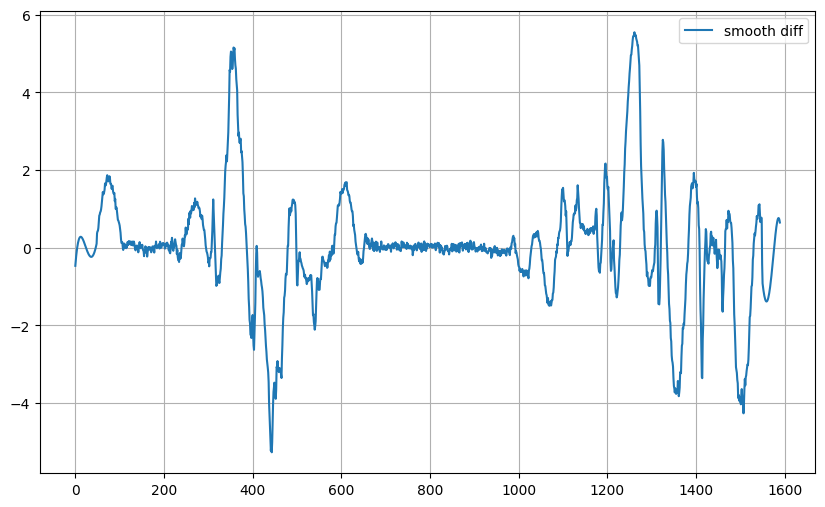

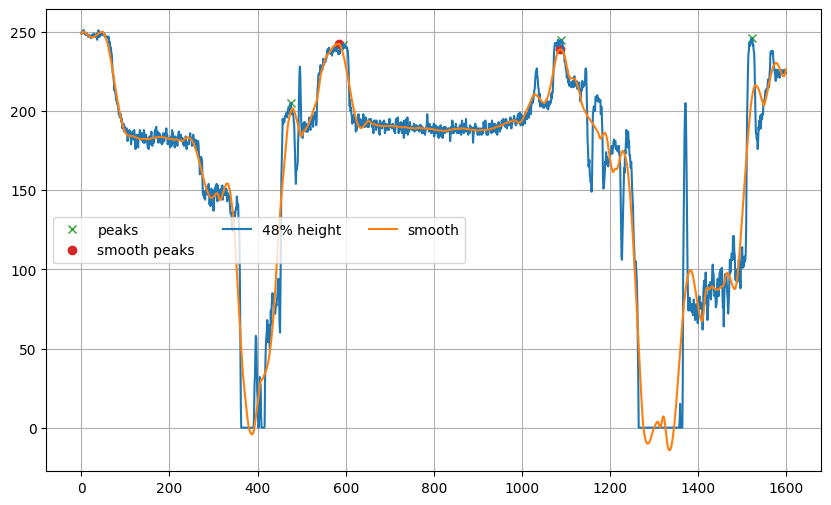

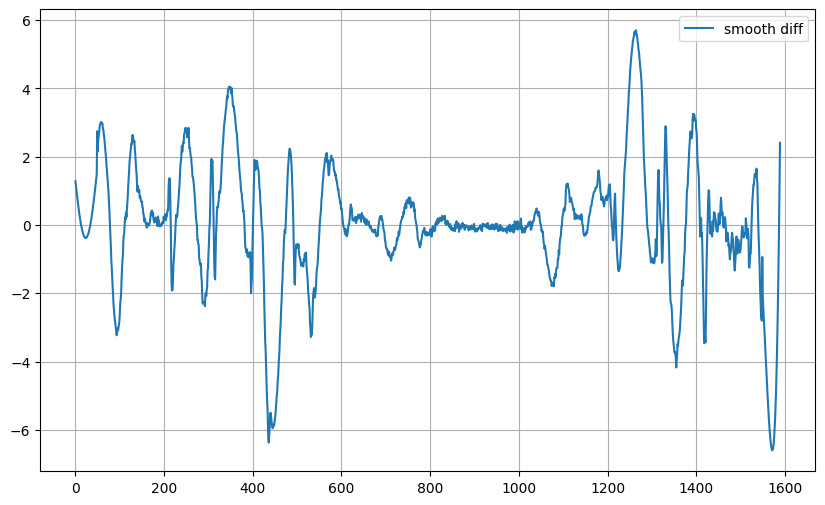

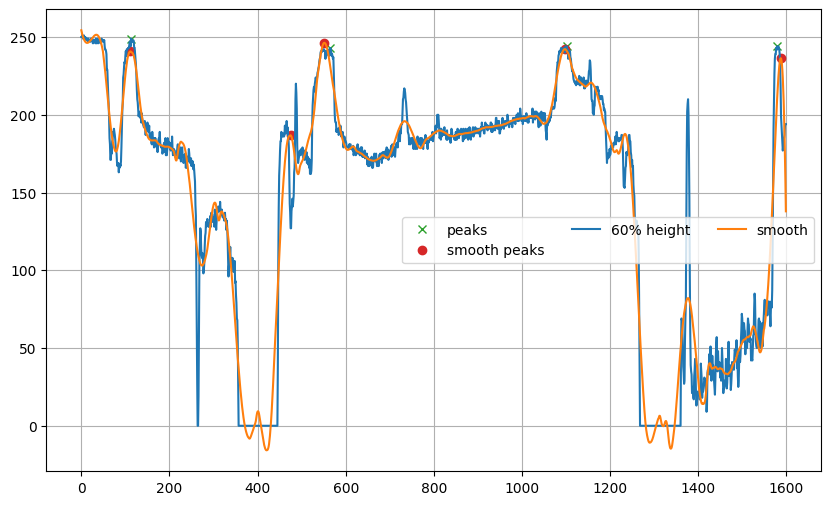

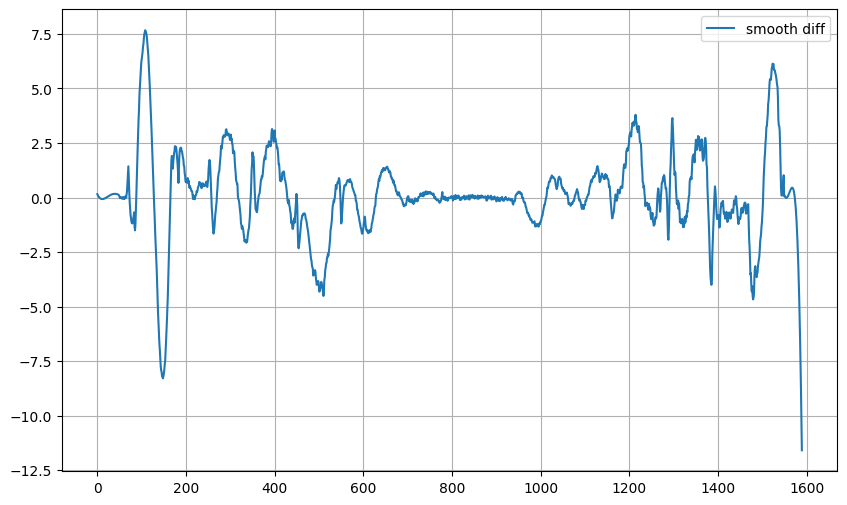

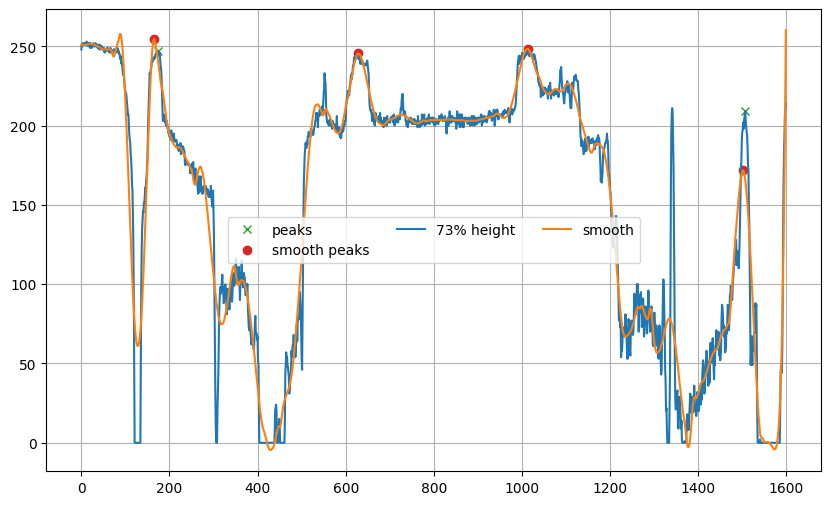

In [95]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(gray_image, cmap='gray')

height, width = gray_image.shape
print(f'Image dimensions: {width}x{height}')

#cross section at the middle of the image

steps=1

points = []
smooth_points = []
h_narrow_points = []
h_plateau_points = []
from scipy.signal import savgol_filter

for k,i in enumerate(np.arange(0.3595,0.79562,0.025)):
    fig1, ax1 = plt.subplots(figsize=(10, 6))
    fig2, ax2 = plt.subplots(figsize=(10, 6))
    cross_section = gray_image[int(height*i), :]
    window_size = 100
    poly_order = 5
    smooth_cross_section = savgol_filter(cross_section, window_size, poly_order)

    x=np.arange(0,len(cross_section))
    max = np.max(cross_section)
    ax2.errorbar(x=x[::steps],y=-(cross_section[::steps]-max),label=f'{int(i*100)}% height')
    ax2.errorbar(x=x[::],y=-(smooth_cross_section[::]-max),label=f'smooth')

    #smooth the cross section use salvgolay filter

    diff = np.diff(cross_section[::steps],append=0)

    smooth_diff = np.diff(smooth_cross_section[::],append=0)
    jerk = np.diff(diff,append=0)

    #ax1.errorbar(x=x[::steps],y=diff[:],label=f'diff {int(i*100)}% height')
    ax1.errorbar(x=x[:-10:],y=smooth_diff[:-10],label=f'smooth diff')
    #ax1.set_xlim(0,width*0.995)
    #ax1.set_ylim(-15,15)
    #ax1.errorbar(x=x[::steps],y=jerk,label=f'jerk {int(i*100)}% height')

    if k%5!=0:
        ax.axhline(y=int(height*i),  linestyle=':')
        plt.close(fig1)
        plt.close(fig2)
    else:
        ax.axhline(y=int(height*i),  linestyle='--') 
    peaks = scipy.signal.find_peaks(-(cross_section-max), height=max*0.75,prominence=50, distance=50, width=15)
    peaks_smooth = scipy.signal.find_peaks(-(smooth_cross_section-max), height=max*0.65,prominence=20, distance=10)  

    print(f'Cross section at {int(i*100)}% height, with {len(peaks[0])} peaks found')
    print(f'Peaks at {peaks[0]} with heights {peaks[1]["peak_heights"]}')
    print("Prominences:", peaks[1]["prominences"])
    ax2.plot(peaks[0], peaks[1]['peak_heights'], "x", label='peaks')
    ax2.plot(peaks_smooth[0], peaks_smooth[1]['peak_heights'], "o", label='smooth peaks')

    xpeaks = int(height*i)*np.ones_like(peaks[0])
    xpeaks_smooth = int(height*i)*np.ones_like(peaks_smooth[0])
    ax.errorbar(y=xpeaks,x=peaks[0], marker='o',fmt=" ", color='red', markersize=5,label='peaks')
    ax.errorbar(y=xpeaks_smooth,x=peaks_smooth[0], marker='o',fmt=" ",markersize=2,color='cyan', label='smooth peaks')

    for j in range(len(peaks[0])):
        points.append((peaks[0][j],int(height*i),peaks[1]['peak_heights'][j]))
    for j in range(len(peaks_smooth[0])):
        smooth_points.append((peaks_smooth[0][j],int(height*i),peaks_smooth[1]['peak_heights'][j]))

# cross_section = gray_image[int(height*0.25), :]
# plt.plot(cross_section,label='25% height')
# cross_section = gray_image[int(height*0.5), :]
# plt.plot(cross_section,label='50% height')
# cross_section = gray_image[int(height*0.75), :]
# plt.plot(cross_section,label='75% height')

    ax1.grid()
    ax1.legend(ncol=3)

    ax2.grid()
    ax2.legend(ncol=3)

## Grab Vertical peaks

Image dimensions: 1600x1200


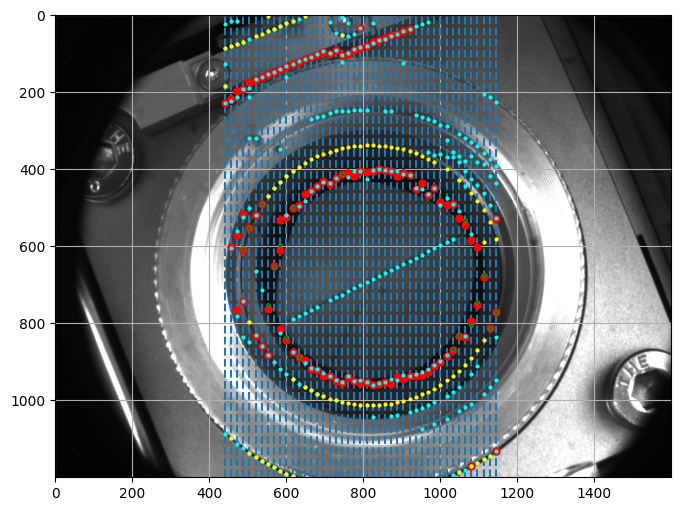

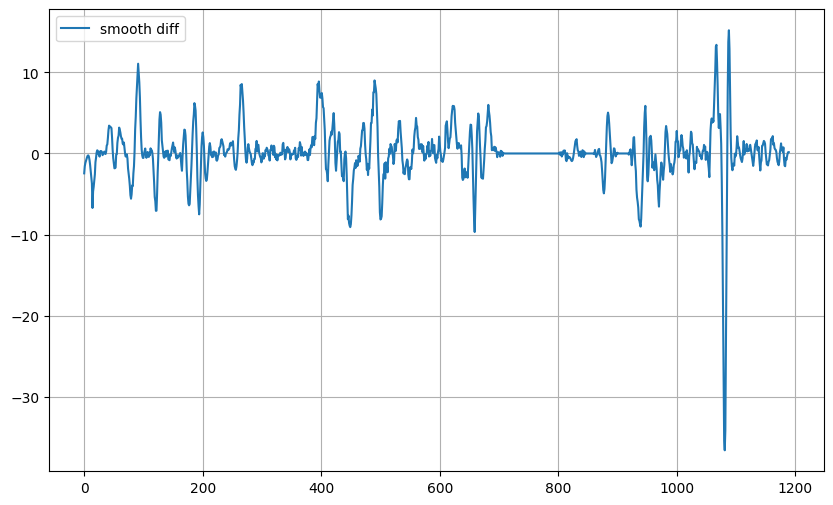

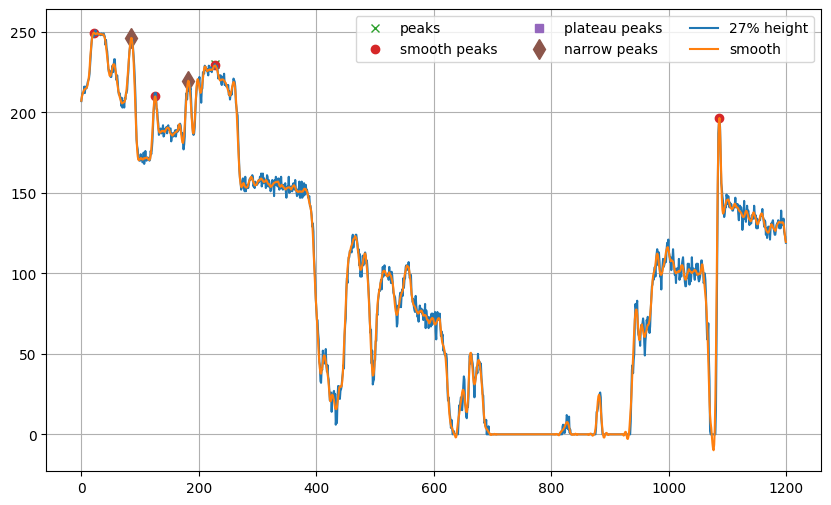

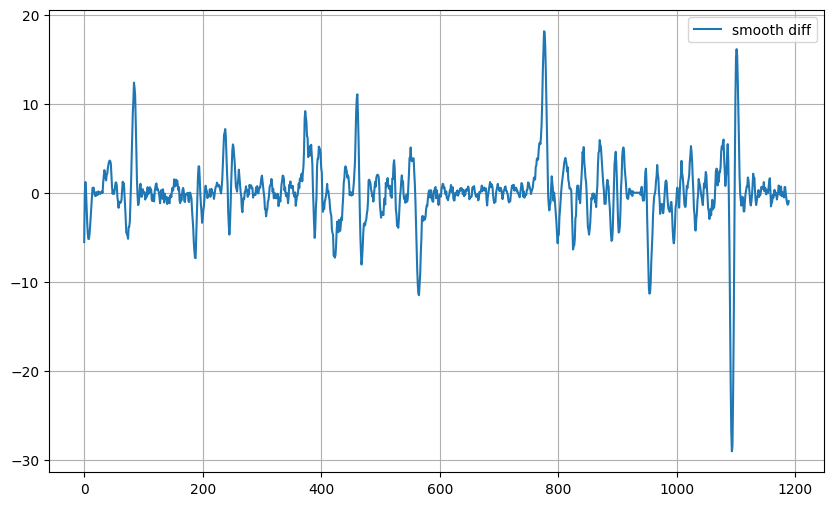

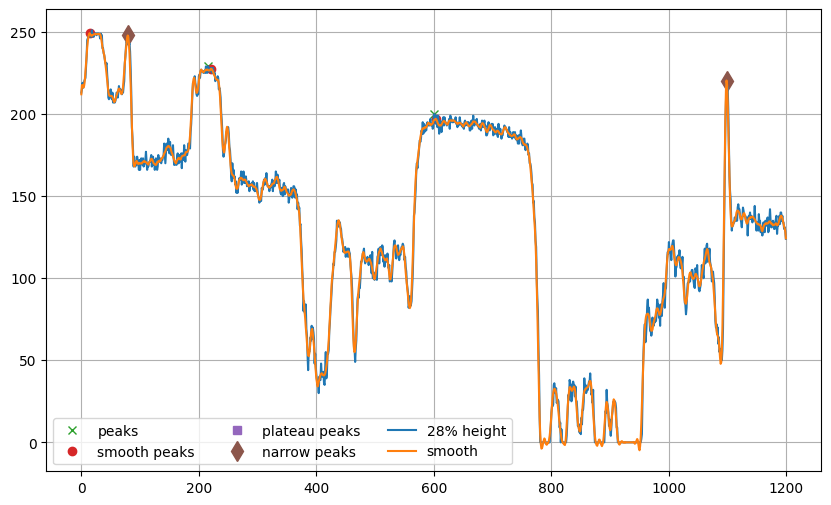

...

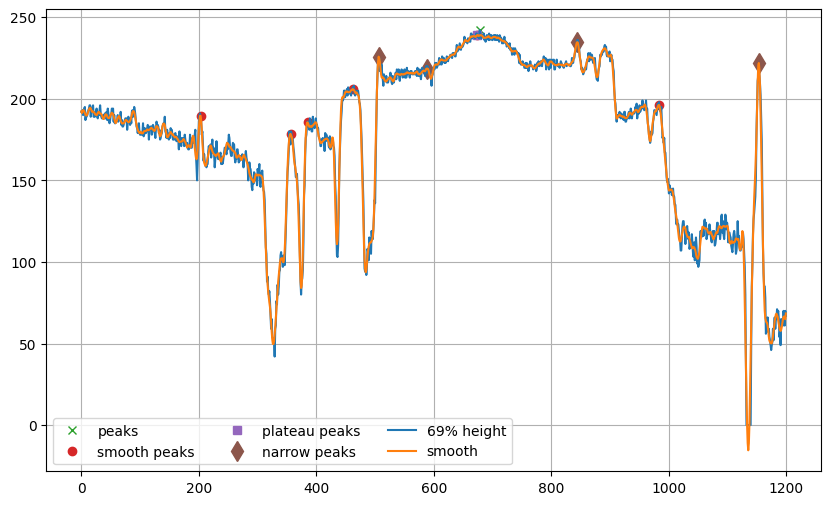

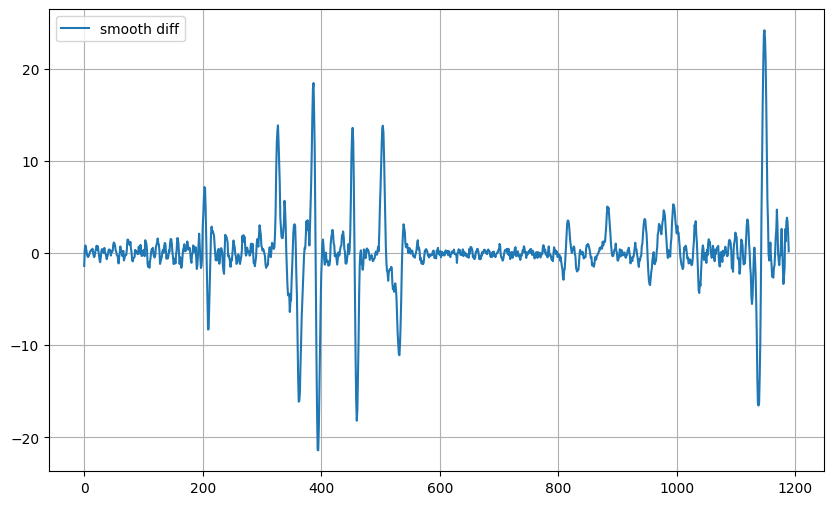

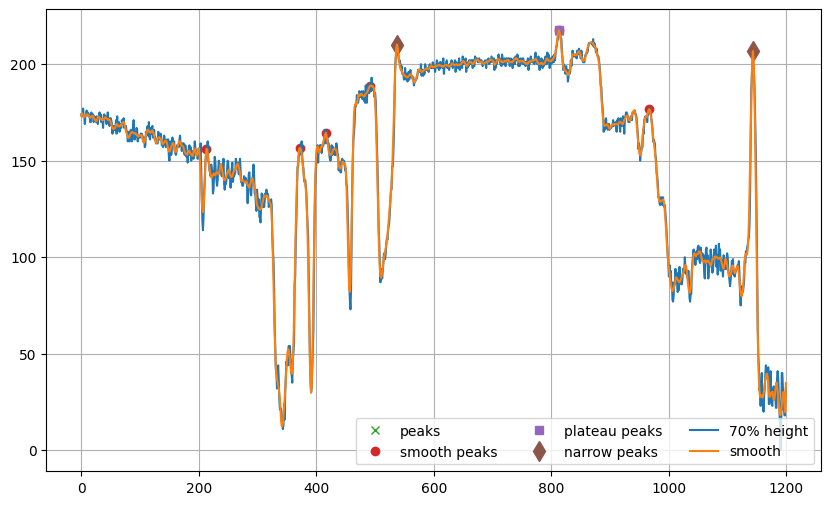

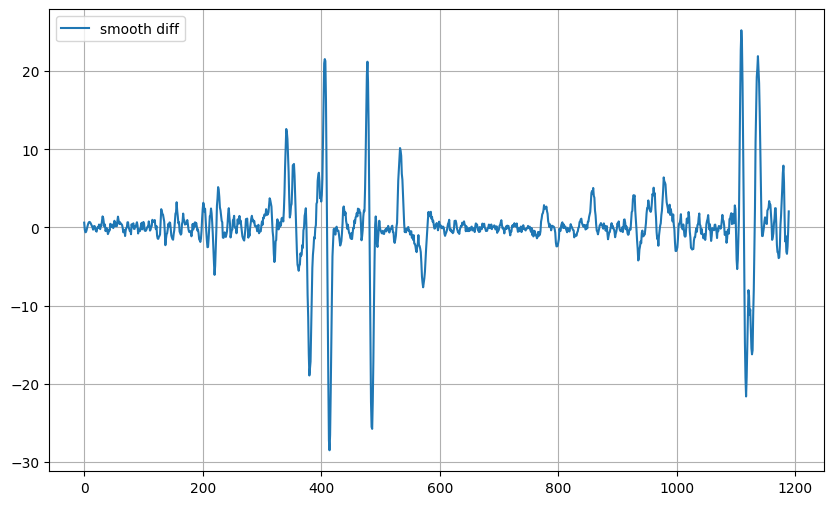

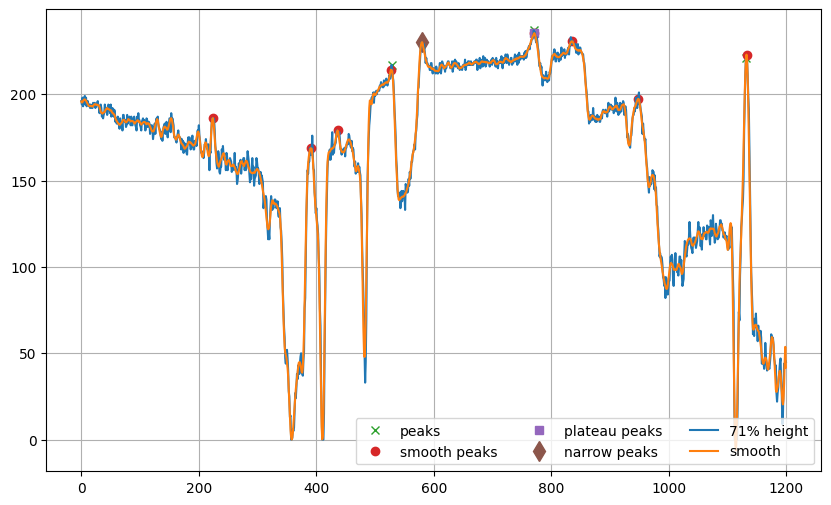

In [96]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(gray_image, cmap='gray')
ax.grid()
height, width = gray_image.shape
print(f'Image dimensions: {width}x{height}')


#cross section at the middle of the image

steps=1

v_points = []
v_smooth_points = []
v_plateau_points = []
v_plateau_points = []
v_narrow_points = []
from scipy.signal import savgol_filter

for k,i in enumerate(np.arange(0.27595,0.72,0.01)):
    fig1, ax1 = plt.subplots(figsize=(10, 6))
    fig2, ax2 = plt.subplots(figsize=(10, 6))
    cross_section = gray_image[:, int(width*i)]
    window_size = 30
    poly_order = 8
    smooth_cross_section = savgol_filter(cross_section, window_size, poly_order)

    x=np.arange(0,len(cross_section))
    max = np.max(cross_section)
    ax2.errorbar(x=x[::steps],y=-(cross_section[::steps]-max),label=f'{int(i*100)}% height')
    ax2.errorbar(x=x[::],y=-(smooth_cross_section[::]-max),label=f'smooth')

    #smooth the cross section use salvgolay filter

    diff = np.diff(cross_section[::steps],append=0)

    smooth_diff = np.diff(smooth_cross_section[::],append=0)
    jerk = np.diff(diff,append=0)

    #ax1.errorbar(x=x[::steps],y=diff[:],label=f'diff {int(i*100)}% height')
    ax1.errorbar(x=x[:-10:],y=smooth_diff[:-10],label=f'smooth diff')
    #ax1.set_xlim(0,width*0.995)
    #ax1.set_ylim(-15,15)
    #ax1.errorbar(x=x[::steps],y=jerk,label=f'jerk {int(i*100)}% height')

    if k%1!=0:
        ax.axvline(x=int(width*i),  linestyle=':')
        plt.close(fig1)
        plt.close(fig2)
    else:
        ax.axvline(x=int(width*i),  linestyle='--') 
    peaks = scipy.signal.find_peaks(-(cross_section-max), height=max*0.75,prominence=50, distance=50, width=15)
    peaks_smooth = scipy.signal.find_peaks(-(smooth_cross_section-max), height=max*0.65,prominence=20, distance=10)  
    peaks_plateau = scipy.signal.find_peaks(-(smooth_cross_section-max), height=max*0.65,prominence=30, distance=5,width=350)
    narrow_peaks = scipy.signal.find_peaks(-(smooth_cross_section-max), height=max*0.85,prominence=5, distance=35,width=(1,15))

    if len(peaks_plateau[0])<0:
        plt.close(fig1)
        plt.close(fig2)
    #print(peaks_plateau)
    # print(f'Cross section at {int(i*100)}% width, with {len(peaks[0])} peaks found')
    # print(f'Peaks at {peaks[0]} with heights {peaks[1]["peak_heights"]}')
    # print("Prominences:", peaks[1]["prominences"])
    ax2.plot(peaks[0], peaks[1]['peak_heights'], "x", label='peaks')
    ax2.plot(peaks_smooth[0], peaks_smooth[1]['peak_heights'], "o", label='smooth peaks')
    ax2.plot(peaks_plateau[0], peaks_plateau[1]['peak_heights'], "s", label='plateau peaks')    
    ax2.plot(narrow_peaks[0], narrow_peaks[1]['peak_heights'], "d", markersize=10, label='narrow peaks')

    xpeaks = int(width*i)*np.ones_like(peaks[0])
    xpeaks_smooth = int(width*i)*np.ones_like(peaks_smooth[0])
    xpeaks_plateau = int(width*i)*np.ones_like(peaks_plateau[0])
    xpeaks_narrow = int(width*i)*np.ones_like(narrow_peaks[0])
    ax.errorbar(x=xpeaks,y=peaks[0], marker='o',fmt=" ", color='red', markersize=5,label='peaks')
    ax.errorbar(x=xpeaks_smooth,y=peaks_smooth[0], marker='o',fmt=" ",markersize=2,color='cyan', label='smooth peaks')
    ax.errorbar(x=xpeaks_plateau,y=peaks_plateau[0], marker='o',fmt=" ",markersize=2,color='green', label='plateau peaks')
    ax.errorbar(x=xpeaks_narrow,y=narrow_peaks[0], marker='o',fmt=" ",markersize=2,color='yellow', label='narrow peaks')
    for j in range(len(peaks[0])):
        v_points.append((int(width*i),peaks[0][j],peaks[1]['peak_heights'][j]))
    for j in range(len(peaks_smooth[0])):
        v_smooth_points.append((int(width*i),peaks_smooth[0][j],peaks_smooth[1]['peak_heights'][j]))
    for j in range(len(peaks_plateau[0])):
        v_plateau_points.append((int(width*i),peaks_plateau[0][j],peaks_plateau[1]['peak_heights'][j]))
    for j in range(len(narrow_peaks[0])):
        v_narrow_points.append((int(width*i),narrow_peaks[0][j],narrow_peaks[1]['peak_heights'][j]))
    

# cross_section = gray_image[int(height*0.25), :]
# plt.plot(cross_section,label='25% height')
# cross_section = gray_image[int(height*0.5), :]
# plt.plot(cross_section,label='50% height')
# cross_section = gray_image[int(height*0.75), :]
# plt.plot(cross_section,label='75% height')

    ax1.grid()
    ax1.legend(ncol=3)

    ax2.grid()
    ax2.legend(ncol=3)

## Fit circles

3D Point Data Analysis
Number of points: 119
X range: 441 to 1145
Y range: 33 to 1171
Z range: 164 to 248

Circle Fitting Results (X-Y Plane)
1. Algebraic Least Squares:
   Center: (805.3, 537.5)
   Radius: 375.5
   RMSE: 127.7
   Max Error: 315.4
   Mean Error: 102.0

2. Geometric Fitting:
   Center: (794.0, 582.0)
   Radius: 357.4
   RMSE: 121.6
   Max Error: 297.8
   Mean Error: 98.6

Detailed Point Analysis (Geometric Fit):
Point#   X      Y      Z    Distance  Error
--------------------------------------------------
 1      441    227   230     500.6  143.2
 2      457    216   229     497.5  140.1
 3      457    601   200     337.5   19.9
 4      473    195   230     502.8  145.4
 5      473    570   205     321.2   36.2
 6      473    766   194     370.0   12.6
 7      489    191   233     495.9  138.5
 8      489    515   207     312.3   45.2
 9      489    608   228     306.1   51.3
10      489    741   222     343.9   13.5
11      505    173   231     500.8  143.4
12      505

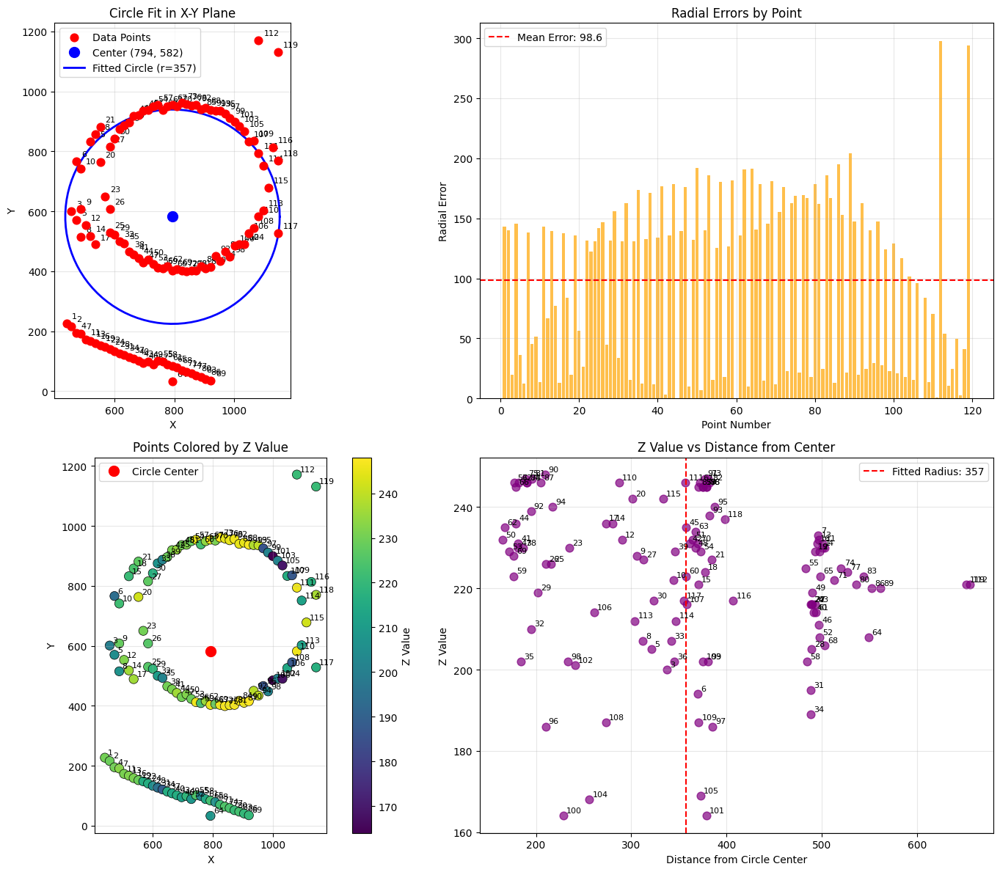


Z-Value Analysis:
Correlation between distance from center and Z: -0.163
Correlation between radial error and Z: 0.045

Z-value statistics:
Mean Z: 222.5
Std Z: 18.9
Min Z: 164.0 (Point 100)
Max Z: 248.0 (Point 90)
Final Results Dictionary:
{'algebraic': {'center': (np.float64(805.3148657809795), np.float64(537.5177333759043)), 'radius': 375.4796750647458, 'quality': {'max_error': np.float64(315.3908449001469), 'mean_error': np.float64(102.00544993741559), 'std_error': np.float64(76.75748270010592), 'rmse': np.float64(127.65901052174759), 'distances': array([478.69257793, 474.02204442, 354.05260047, 477.23324245,
       333.89858889, 403.28317121, 469.17974579, 317.11534594,
       324.0722824 , 376.11185457, 472.2946078 , 300.71368308,
       467.03140542, 284.98400801, 409.33451877, 463.97041035,
       272.66616521, 417.97338482, 460.7458239 , 338.38593951,
       426.19579888, 455.597169  , 261.71926963, 453.61321957,
       220.44309107, 231.31448289, 354.30925528, 453.18777675,


In [97]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
import math

class CircleFitter:
    @staticmethod
    def geometric_circle_fit(points):
        """Find the best-fit circle using geometric distance minimization."""
        points = np.array(points)
        
        # Use centroid as initial center guess
        center_x = np.mean(points[:, 0])
        center_y = np.mean(points[:, 1])
        
        # Initial radius as average distance from centroid
        distances = np.sqrt((points[:, 0] - center_x)**2 + (points[:, 1] - center_y)**2)
        radius = np.mean(distances)
        
        initial_guess = (center_x, center_y, radius)
        
        def objective(params):
            cx, cy, r = params
            distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
            return np.sum((distances - r)**2)
        
        # Optimize
        result = minimize(objective, initial_guess, method='Nelder-Mead')
        
        if not result.success:
            print("Warning: Optimization may not have converged")
        
        cx, cy, r = result.x
        return ((cx, cy), abs(r))
    
    @staticmethod
    def least_squares_circle(points):
        """Find the best-fit circle using algebraic least squares."""
        points = np.array(points)
        n = len(points)
        
        if n < 3:
            raise ValueError("Need at least 3 points")
        
        # Set up the system: x² + y² + Dx + Ey + F = 0
        A = np.zeros((n, 3))
        b = np.zeros(n)
        
        for i, (x, y) in enumerate(points):
            A[i] = [x, y, 1]
            b[i] = -(x**2 + y**2)
        
        # Solve the least squares problem
        coeffs, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
        D, E, F = coeffs
        
        # Convert to center-radius form
        center_x = -D / 2
        center_y = -E / 2
        radius = math.sqrt(D**2 + E**2 - 4*F) / 2
        
        return ((center_x, center_y), radius)
    
    @staticmethod
    def calculate_fit_quality(points, center, radius):
        """Calculate fit quality metrics."""
        points = np.array(v_points)
        cx, cy = center
        
        # Calculate distances from each point to the center
        distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
        
        # Calculate errors (deviation from ideal radius)
        errors = np.abs(distances - radius)
        
        return {
            'max_error': np.max(errors),
            'mean_error': np.mean(errors),
            'std_error': np.std(errors),
            'rmse': np.sqrt(np.mean(errors**2)),
            'distances': distances,
            'errors': errors
        }

def analyze_3d_points(points):
    """Analyze the specific 3D point data provided."""
    
    # Your data points [x, y, z]
    data_3d = np.array(points)
    
    print("3D Point Data Analysis")
    print("=" * 50)
    print(f"Number of points: {len(data_3d)}")
    print(f"X range: {data_3d[:, 0].min():.0f} to {data_3d[:, 0].max():.0f}")
    print(f"Y range: {data_3d[:, 1].min():.0f} to {data_3d[:, 1].max():.0f}")
    print(f"Z range: {data_3d[:, 2].min():.0f} to {data_3d[:, 2].max():.0f}")
    
    # Extract X,Y coordinates for circle fitting
    xy_points = data_3d[:, :2]  # Take only X,Y columns
    
    print("\nCircle Fitting Results (X-Y Plane)")
    print("=" * 40)
    
    # Method 1: Algebraic Least Squares
    center_alg, radius_alg = CircleFitter.least_squares_circle(xy_points)
    quality_alg = CircleFitter.calculate_fit_quality(xy_points, center_alg, radius_alg)
    
    print("1. Algebraic Least Squares:")
    print(f"   Center: ({center_alg[0]:.1f}, {center_alg[1]:.1f})")
    print(f"   Radius: {radius_alg:.1f}")
    print(f"   RMSE: {quality_alg['rmse']:.1f}")
    print(f"   Max Error: {quality_alg['max_error']:.1f}")
    print(f"   Mean Error: {quality_alg['mean_error']:.1f}")
    
    # Method 2: Geometric Fitting
    center_geo, radius_geo = CircleFitter.geometric_circle_fit(xy_points)
    quality_geo = CircleFitter.calculate_fit_quality(xy_points, center_geo, radius_geo)
    
    print("\n2. Geometric Fitting:")
    print(f"   Center: ({center_geo[0]:.1f}, {center_geo[1]:.1f})")
    print(f"   Radius: {radius_geo:.1f}")
    print(f"   RMSE: {quality_geo['rmse']:.1f}")
    print(f"   Max Error: {quality_geo['max_error']:.1f}")
    print(f"   Mean Error: {quality_geo['mean_error']:.1f}")
    
    # Detailed point analysis
    print("\nDetailed Point Analysis (Geometric Fit):")
    print("Point#   X      Y      Z    Distance  Error")
    print("-" * 50)
    for i, (point, distance, error) in enumerate(zip(data_3d, quality_geo['distances'], quality_geo['errors'])):
        print(f"{i+1:2d}   {point[0]:6.0f} {point[1]:6.0f} {point[2]:5.0f}   {distance:7.1f}  {error:5.1f}")
    
    # Create visualization
    create_visualization(data_3d, xy_points, center_geo, radius_geo, quality_geo)
    
    # Analyze Z-values in relation to circle position
    analyze_z_correlation(data_3d, center_geo, radius_geo)
    
    return {
        'algebraic': {'center': center_alg, 'radius': radius_alg, 'quality': quality_alg},
        'geometric': {'center': center_geo, 'radius': radius_geo, 'quality': quality_geo},
        'data_3d': data_3d,
        'xy_points': xy_points
    }

def create_visualization(data_3d, xy_points, center, radius, quality):
    """Create comprehensive visualization of the circle fit."""
    
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 12))
    
    # Plot 1: Circle fit in X-Y plane
    ax1.scatter(xy_points[:, 0], xy_points[:, 1], color='red', s=60, zorder=5, label='Data Points')
    ax1.plot(center[0], center[1], 'bo', markersize=10, label=f'Center ({center[0]:.0f}, {center[1]:.0f})')
    
    # Draw fitted circle
    theta = np.linspace(0, 2*np.pi, 100)
    circle_x = center[0] + radius * np.cos(theta)
    circle_y = center[1] + radius * np.sin(theta)
    ax1.plot(circle_x, circle_y, 'b-', linewidth=2, label=f'Fitted Circle (r={radius:.0f})')
    
    # Add point numbers
    for i, (x, y) in enumerate(xy_points):
        ax1.annotate(f'{i+1}', (x, y), xytext=(5, 5), textcoords='offset points', fontsize=8)
    
    ax1.set_aspect('equal')
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    ax1.set_title('Circle Fit in X-Y Plane')
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    
    # Plot 2: Error distribution
    distances = quality['distances']
    errors = quality['errors']
    
    ax2.bar(range(1, len(errors)+1), errors, color='orange', alpha=0.7)
    ax2.axhline(quality['mean_error'], color='red', linestyle='--', label=f'Mean Error: {quality["mean_error"]:.1f}')
    ax2.set_xlabel('Point Number')
    ax2.set_ylabel('Radial Error')
    ax2.set_title('Radial Errors by Point')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # Plot 3: 3D scatter with color-coded Z values
    scatter = ax3.scatter(data_3d[:, 0], data_3d[:, 1], c=data_3d[:, 2], 
                         cmap='viridis', s=80, edgecolors='black', linewidth=0.5)
    ax3.plot(center[0], center[1], 'ro', markersize=10, label='Circle Center')
    
    # Add colorbar for Z values
    plt.colorbar(scatter, ax=ax3, label='Z Value')
    
    for i, (x, y, z) in enumerate(data_3d):
        ax3.annotate(f'{i+1}', (x, y), xytext=(3, 3), textcoords='offset points', fontsize=8)
    
    ax3.set_aspect('equal')
    ax3.grid(True, alpha=0.3)
    ax3.legend()
    ax3.set_title('Points Colored by Z Value')
    ax3.set_xlabel('X')
    ax3.set_ylabel('Y')
    
    # Plot 4: Distance from center vs Z value
    center_distances = np.sqrt((data_3d[:, 0] - center[0])**2 + (data_3d[:, 1] - center[1])**2)
    
    ax4.scatter(center_distances, data_3d[:, 2], color='purple', s=60, alpha=0.7)
    ax4.axvline(radius, color='red', linestyle='--', label=f'Fitted Radius: {radius:.0f}')
    
    for i, (dist, z) in enumerate(zip(center_distances, data_3d[:, 2])):
        ax4.annotate(f'{i+1}', (dist, z), xytext=(3, 3), textcoords='offset points', fontsize=8)
    
    ax4.set_xlabel('Distance from Circle Center')
    ax4.set_ylabel('Z Value')
    ax4.set_title('Z Value vs Distance from Center')
    ax4.legend()
    ax4.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

def analyze_z_correlation(data_3d, center, radius):
    """Analyze correlation between Z values and position relative to circle."""
    
    print("\nZ-Value Analysis:")
    print("=" * 20)
    
    # Calculate distances from circle center
    distances = np.sqrt((data_3d[:, 0] - center[0])**2 + (data_3d[:, 1] - center[1])**2)
    z_values = data_3d[:, 2]
    
    # Correlation between distance from center and Z
    correlation_dist_z = np.corrcoef(distances, z_values)[0, 1]
    print(f"Correlation between distance from center and Z: {correlation_dist_z:.3f}")
    
    # Correlation between radial error and Z
    radial_errors = np.abs(distances - radius)
    correlation_error_z = np.corrcoef(radial_errors, z_values)[0, 1]
    print(f"Correlation between radial error and Z: {correlation_error_z:.3f}")
    
    # Basic statistics
    print(f"\nZ-value statistics:")
    print(f"Mean Z: {np.mean(z_values):.1f}")
    print(f"Std Z: {np.std(z_values):.1f}")
    print(f"Min Z: {np.min(z_values):.1f} (Point {np.argmin(z_values)+1})")
    print(f"Max Z: {np.max(z_values):.1f} (Point {np.argmax(z_values)+1})")

if __name__ == "__main__":
    results = analyze_3d_points(v_points)


    print("Final Results Dictionary:")
    print(results)

Multi-Circle Analysis of 3D Point Data
Total points: 119
X range: 441 to 1145
Y range: 33 to 1171
Z range: 164 to 248

METHOD 1: RANSAC-based Detection
RANSAC Circle Detection (threshold: 80)
Circle 1:
  Center: (835.5, 690.0)
  Radius: 265.7
  Points: 18 ([66, 69, 72, 75, 78, 81, 84, 87, 90, 92, 94, 96, 98, 100, 102, 104, 106, 108])
  RMSE: 4.5

Circle 2:
  Center: (819.9, 653.1)
  Radius: 250.9
  Points: 30 ([22, 24, 25, 28, 31, 34, 37, 40, 43, 46, 49, 52, 55, 58, 61, 65, 68, 71, 74, 77, 80, 83, 86, 89, 91, 93, 95, 97, 99, 101])
  RMSE: 7.0

Circle 3:
  Center: (601.7, -356.3)
  Radius: 471.1
  Points: 14 ([33, 36, 39, 42, 45, 48, 51, 54, 57, 60, 63, 64, 67, 70])
  RMSE: 12.6

Unassigned points: 57 ([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 26, 27, 29, 30, 32, 35, 38, 41, 44, 47, 50, 53, 56, 59, 62, 73, 76, 79, 82, 85, 88, 103, 105, 107, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118])

METHOD 2: Clustering-based Detection
Clustering-based C

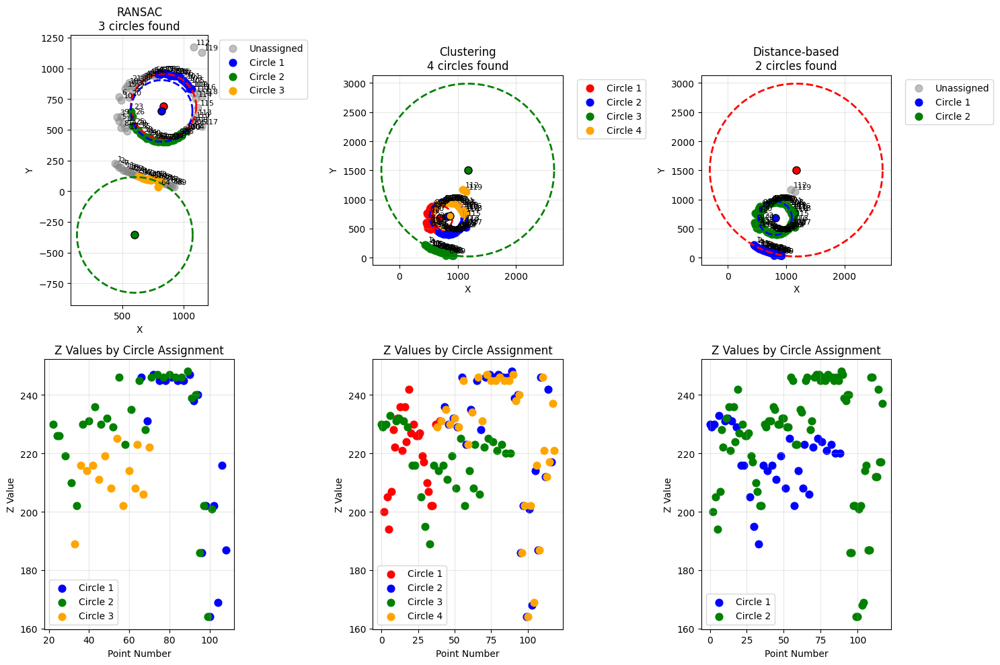


SUMMARY COMPARISON
RANSAC:
  Circles found: 3
  Points assigned: 62
  Points unassigned: 57



ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [98]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from sklearn.cluster import DBSCAN, KMeans
from sklearn.metrics import silhouette_score
import math
from itertools import combinations
import warnings
warnings.filterwarnings('ignore')

class MultiCircleFitter:
    def __init__(self):
        self.circles = []
        self.point_assignments = []
        
    @staticmethod
    def geometric_circle_fit(points):
        """Find the best-fit circle using geometric distance minimization."""
        points = np.array(points)
        
        if len(points) < 3:
            return None
            
        # Use centroid as initial center guess
        center_x = np.mean(points[:, 0])
        center_y = np.mean(points[:, 1])
        
        # Initial radius as average distance from centroid
        distances = np.sqrt((points[:, 0] - center_x)**2 + (points[:, 1] - center_y)**2)
        radius = np.mean(distances)
        
        initial_guess = (center_x, center_y, radius)
        
        def objective(params):
            cx, cy, r = params
            if r <= 0:
                return 1e10
            distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
            return np.sum((distances - r)**2)
        
        # Optimize with bounds to ensure positive radius
        bounds = [(None, None), (None, None), (1e-6, None)]
        result = minimize(objective, initial_guess, method='L-BFGS-B', bounds=bounds)
        
        if not result.success:
            # Fallback to simpler method
            result = minimize(objective, initial_guess, method='Nelder-Mead')
        
        cx, cy, r = result.x
        return ((cx, cy), abs(r), result.fun)
    
    @staticmethod
    def calculate_fit_quality(points, center, radius):
        """Calculate fit quality metrics."""
        points = np.array(points)
        cx, cy = center
        
        distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
        errors = np.abs(distances - radius)
        
        return {
            'max_error': np.max(errors),
            'mean_error': np.mean(errors),
            'std_error': np.std(errors),
            'rmse': np.sqrt(np.mean(errors**2)),
            'distances': distances,
            'errors': errors
        }
    
    def detect_circles_ransac(self, points, max_circles=4, min_points=3, max_iterations=1000, distance_threshold=50):
        """
        Use RANSAC-like approach to detect multiple circles.
        """
        points = np.array(points)
        remaining_points = list(range(len(points)))
        circles_found = []
        point_assignments = [-1] * len(points)  # -1 means unassigned
        
        print(f"RANSAC Circle Detection (threshold: {distance_threshold})")
        print("=" * 50)
        
        for circle_id in range(max_circles):
            if len(remaining_points) < min_points:
                break
                
            best_circle = None
            best_inliers = []
            best_score = float('inf')
            
            # Try random combinations of 3 points
            for iteration in range(max_iterations // max_circles):
                if len(remaining_points) < 3:
                    break
                    
                # Randomly sample 3 points
                sample_indices = np.random.choice(remaining_points, 3, replace=False)
                sample_points = points[sample_indices]
                
                # Fit circle to these 3 points
                try:
                    circle_result = self.three_point_circle(sample_points[0], sample_points[1], sample_points[2])
                    if circle_result is None:
                        continue
                        
                    center, radius = circle_result
                    
                    # Find inliers among remaining points
                    inliers = []
                    for idx in remaining_points:
                        point = points[idx]
                        distance_to_center = np.sqrt((point[0] - center[0])**2 + (point[1] - center[1])**2)
                        error = abs(distance_to_center - radius)
                        
                        if error < distance_threshold:
                            inliers.append(idx)
                    
                    # Need at least min_points inliers
                    if len(inliers) >= min_points:
                        # Refit circle using all inliers
                        inlier_points = points[inliers]
                        refined_result = self.geometric_circle_fit(inlier_points)
                        
                        if refined_result:
                            refined_center, refined_radius, score = refined_result
                            
                            # Check if this is the best circle so far
                            if score < best_score:
                                best_circle = (refined_center, refined_radius)
                                best_inliers = inliers.copy()
                                best_score = score
                                
                except:
                    continue
            
            # If we found a good circle, add it
            if best_circle and len(best_inliers) >= min_points:
                circles_found.append(best_circle)
                
                # Assign points to this circle
                for idx in best_inliers:
                    point_assignments[idx] = circle_id
                    if idx in remaining_points:
                        remaining_points.remove(idx)
                
                center, radius = best_circle
                quality = self.calculate_fit_quality(points[best_inliers], center, radius)
                
                print(f"Circle {circle_id + 1}:")
                print(f"  Center: ({center[0]:.1f}, {center[1]:.1f})")
                print(f"  Radius: {radius:.1f}")
                print(f"  Points: {len(best_inliers)} ({best_inliers})")
                print(f"  RMSE: {quality['rmse']:.1f}")
                print()
            else:
                break
        
        # Handle unassigned points
        unassigned = [i for i, assignment in enumerate(point_assignments) if assignment == -1]
        if unassigned:
            print(f"Unassigned points: {len(unassigned)} ({unassigned})")
        
        self.circles = circles_found
        self.point_assignments = point_assignments
        return circles_found, point_assignments
    
    def detect_circles_clustering(self, points, method='auto', max_circles=4):
        """
        Use clustering to detect multiple circles.
        """
        points = np.array(points)
        
        print(f"Clustering-based Circle Detection")
        print("=" * 40)
        
        best_assignment = None
        best_circles = []
        best_score = -1
        
        # Try different numbers of clusters
        for n_clusters in range(2, min(max_circles + 1, len(points) - 1)):
            
            if method == 'kmeans' or method == 'auto':
                # Try K-means clustering
                kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
                cluster_labels = kmeans.fit_predict(points)
                
                # Calculate silhouette score
                if len(np.unique(cluster_labels)) > 1:
                    score = silhouette_score(points, cluster_labels)
                    
                    # Try to fit circles to each cluster
                    circles = []
                    valid_clusters = 0
                    
                    for cluster_id in range(n_clusters):
                        cluster_points = points[cluster_labels == cluster_id]
                        
                        if len(cluster_points) >= 3:
                            circle_result = self.geometric_circle_fit(cluster_points)
                            if circle_result:
                                center, radius, fit_error = circle_result
                                circles.append((center, radius))
                                valid_clusters += 1
                    
                    # Adjust score based on circle fit quality
                    if valid_clusters == n_clusters:
                        adjusted_score = score * (valid_clusters / n_clusters)
                        
                        if adjusted_score > best_score:
                            best_score = adjusted_score
                            best_assignment = cluster_labels.copy()
                            best_circles = circles.copy()
        
        if best_assignment is not None:
            print(f"Best clustering: {len(best_circles)} circles (silhouette score: {best_score:.3f})")
            
            for i, (center, radius) in enumerate(best_circles):
                cluster_points_idx = np.where(best_assignment == i)[0]
                cluster_points = points[cluster_points_idx]
                quality = self.calculate_fit_quality(cluster_points, center, radius)
                
                print(f"Circle {i + 1}:")
                print(f"  Center: ({center[0]:.1f}, {center[1]:.1f})")
                print(f"  Radius: {radius:.1f}")
                print(f"  Points: {len(cluster_points_idx)} ({list(cluster_points_idx)})")
                print(f"  RMSE: {quality['rmse']:.1f}")
                print()
        
        self.circles = best_circles
        self.point_assignments = best_assignment.tolist() if best_assignment is not None else []
        return best_circles, best_assignment
    
    def detect_circles_hierarchical(self, points, distance_threshold=100):
        """
        Use distance-based hierarchical approach to detect circles.
        """
        points = np.array(points)
        
        print(f"Distance-based Circle Detection (threshold: {distance_threshold})")
        print("=" * 50)
        
        # Calculate pairwise distances
        n_points = len(points)
        distances = np.zeros((n_points, n_points))
        
        for i in range(n_points):
            for j in range(i+1, n_points):
                dist = np.sqrt((points[i][0] - points[j][0])**2 + (points[i][1] - points[j][1])**2)
                distances[i][j] = distances[j][i] = dist
        
        # Use DBSCAN clustering based on spatial proximity
        dbscan = DBSCAN(eps=distance_threshold, min_samples=3, metric='precomputed')
        cluster_labels = dbscan.fit_predict(distances)
        
        # Fit circles to each cluster
        circles = []
        unique_labels = set(cluster_labels)
        
        for label in unique_labels:
            if label == -1:  # Noise points
                continue
                
            cluster_points_idx = np.where(cluster_labels == label)[0]
            cluster_points = points[cluster_points_idx]
            
            if len(cluster_points) >= 3:
                circle_result = self.geometric_circle_fit(cluster_points)
                if circle_result:
                    center, radius, _ = circle_result
                    circles.append((center, radius))
                    quality = self.calculate_fit_quality(cluster_points, center, radius)
                    
                    print(f"Circle {len(circles)}:")
                    print(f"  Center: ({center[0]:.1f}, {center[1]:.1f})")
                    print(f"  Radius: {radius:.1f}")
                    print(f"  Points: {len(cluster_points_idx)} ({list(cluster_points_idx)})")
                    print(f"  RMSE: {quality['rmse']:.1f}")
                    print()
        
        # Handle noise points
        noise_points = np.where(cluster_labels == -1)[0]
        if len(noise_points) > 0:
            print(f"Noise points: {len(noise_points)} ({list(noise_points)})")
        
        self.circles = circles
        self.point_assignments = cluster_labels.tolist()
        return circles, cluster_labels
    
    @staticmethod
    def three_point_circle(p1, p2, p3):
        """Calculate circle through three points."""
        x1, y1 = p1
        x2, y2 = p2
        x3, y3 = p3
        
        det = 2 * (x1 * (y2 - y3) + x2 * (y3 - y1) + x3 * (y1 - y2))
        
        if abs(det) < 1e-10:
            return None
        
        ux = ((x1**2 + y1**2) * (y2 - y3) + 
              (x2**2 + y2**2) * (y3 - y1) + 
              (x3**2 + y3**2) * (y1 - y2)) / det
              
        uy = ((x1**2 + y1**2) * (x3 - x2) + 
              (x2**2 + y2**2) * (x1 - x3) + 
              (x3**2 + y3**2) * (x2 - x1)) / det
        
        radius = math.sqrt((ux - x1)**2 + (uy - y1)**2)
        
        return ((ux, uy), radius)

def analyze_multiple_circles(points):
    """Analyze the 3D point data for multiple circles."""
    
    # Your data points [x, y, z]
    data_3d = np.array(points)
    
    print("Multi-Circle Analysis of 3D Point Data")
    print("=" * 60)
    print(f"Total points: {len(data_3d)}")
    print(f"X range: {data_3d[:, 0].min():.0f} to {data_3d[:, 0].max():.0f}")
    print(f"Y range: {data_3d[:, 1].min():.0f} to {data_3d[:, 1].max():.0f}")
    print(f"Z range: {data_3d[:, 2].min():.0f} to {data_3d[:, 2].max():.0f}")
    print()
    
    # Extract X,Y coordinates
    xy_points = data_3d[:, :2]
    
    # Create multi-circle fitter
    fitter = MultiCircleFitter()
    
    # Method 1: RANSAC-based detection
    print("METHOD 1: RANSAC-based Detection")
    circles_ransac, assignments_ransac = fitter.detect_circles_ransac(
        xy_points, max_circles=3, distance_threshold=80
    )
    
    # Method 2: Clustering-based detection
    print("\nMETHOD 2: Clustering-based Detection")
    fitter2 = MultiCircleFitter()
    circles_clustering, assignments_clustering = fitter2.detect_circles_clustering(
        xy_points, method='auto', max_circles=4
    )
    
    # Method 3: Distance-based hierarchical
    print("\nMETHOD 3: Distance-based Detection")
    fitter3 = MultiCircleFitter()
    circles_distance, assignments_distance = fitter3.detect_circles_hierarchical(
        xy_points, distance_threshold=200
    )
    
    # Create comprehensive visualization
    create_multi_circle_visualization(
        data_3d, xy_points,
        [
            ("RANSAC", circles_ransac, assignments_ransac),
            ("Clustering", circles_clustering, assignments_clustering), 
            ("Distance-based", circles_distance, assignments_distance)
        ]
    )
    
    return {
        'ransac': {'circles': circles_ransac, 'assignments': assignments_ransac},
        'clustering': {'circles': circles_clustering, 'assignments': assignments_clustering},
        'distance': {'circles': circles_distance, 'assignments': assignments_distance},
        'data': data_3d
    }

def create_multi_circle_visualization(data_3d, xy_points, methods):
    """Create visualization comparing different multi-circle detection methods."""
    
    n_methods = len(methods)
    fig, axes = plt.subplots(2, n_methods, figsize=(5*n_methods, 10))
    
    if n_methods == 1:
        axes = axes.reshape(2, 1)
    
    colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink']
    
    for i, (method_name, circles, assignments) in enumerate(methods):
        # Top row: Circle fits with point assignments
        ax1 = axes[0, i]
        
        if assignments is not None and len(circles) > 0:
            assignments = np.array(assignments)
            
            # Plot points colored by assignment
            unique_labels = np.unique(assignments)
            for j, label in enumerate(unique_labels):
                if label == -1:  # Unassigned/noise points
                    mask = assignments == label
                    ax1.scatter(xy_points[mask, 0], xy_points[mask, 1], 
                              color='gray', s=60, alpha=0.5, label='Unassigned')
                else:
                    mask = assignments == label
                    color = colors[j % len(colors)]
                    ax1.scatter(xy_points[mask, 0], xy_points[mask, 1], 
                              color=color, s=60, label=f'Circle {label+1}')
            
            # Plot fitted circles
            for j, (center, radius) in enumerate(circles):
                color = colors[j % len(colors)]
                theta = np.linspace(0, 2*np.pi, 100)
                circle_x = center[0] + radius * np.cos(theta)
                circle_y = center[1] + radius * np.sin(theta)
                ax1.plot(circle_x, circle_y, color=color, linewidth=2, linestyle='--')
                ax1.plot(center[0], center[1], 'o', color=color, markersize=8, 
                        markeredgecolor='black', markeredgewidth=1)
        else:
            # No circles found
            ax1.scatter(xy_points[:, 0], xy_points[:, 1], color='gray', s=60)
        
        # Add point numbers
        for k, (x, y) in enumerate(xy_points):
            ax1.annotate(f'{k+1}', (x, y), xytext=(3, 3), textcoords='offset points', fontsize=8)
        
        ax1.set_aspect('equal')
        ax1.grid(True, alpha=0.3)
        ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        ax1.set_title(f'{method_name}\n{len(circles)} circles found')
        ax1.set_xlabel('X')
        ax1.set_ylabel('Y')
        
        # Bottom row: Z-values analysis
        ax2 = axes[1, i]
        
        if assignments is not None and len(circles) > 0:
            assignments = np.array(assignments)
            unique_labels = np.unique(assignments)
            
            for j, label in enumerate(unique_labels):
                if label == -1:
                    mask = assignments == label
                    if np.any(mask):
                        try:
                            ax2.scatter(range(len(data_3d))[mask], data_3d[mask, 2], 
                                  color='gray', s=60, alpha=0.5, label='Unassigned')
                        except Exception as e:
                            print("Error plotting unassigned points:", e)
                else:
                    mask = assignments == label
                    if np.any(mask):
                        color = colors[j % len(colors)]
                        points_in_circle = np.where(mask)[0]
                        ax2.scatter(points_in_circle, data_3d[mask, 2], 
                                  color=color, s=60, label=f'Circle {label+1}')
        else:
            ax2.scatter(range(len(data_3d)), data_3d[:, 2], color='gray', s=60)
        
        ax2.set_xlabel('Point Number')
        ax2.set_ylabel('Z Value')
        ax2.set_title('Z Values by Circle Assignment')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

def summarize_results(results):
    """Summarize and compare the different methods."""
    print("\nSUMMARY COMPARISON")
    print("=" * 50)
    
    methods = ['ransac', 'clustering', 'distance']
    method_names = ['RANSAC', 'Clustering', 'Distance-based']
    
    for i, (method, name) in enumerate(zip(methods, method_names)):
        result = results[method]
        n_circles = len(result['circles'])
        assignments = result['assignments']
        
        if assignments:
            n_assigned = len([a for a in assignments if a != -1])
            n_unassigned = len([a for a in assignments if a == -1])
        else:
            n_assigned = 0
            n_unassigned = len(results['data'])
        
        print(f"{name}:")
        print(f"  Circles found: {n_circles}")
        print(f"  Points assigned: {n_assigned}")
        print(f"  Points unassigned: {n_unassigned}")
        print()

if __name__ == "__main__":
    results = analyze_multiple_circles(v_points)
    summarize_results(results)

In [ ]:
def fit_circles_same_center(points, initial_center):
    """
    Given an array of points and an initial guess for the center,
    find the center that minimizes the variance of the distances (radii)
    from the center to each point.
    Returns the optimized center and the radii.
    """
    points = np.asarray(points)
    def radii(center):
        return np.sqrt(np.sum((points - center)**2, axis=1))
    def variance(center):
        r = radii(center)
        return np.var(r)
    result = minimize(variance, initial_center)
    center_opt = result.x
    radii_opt = radii(center_opt)
    return center_opt, radii_opt

import numpy as np
from scipy.optimize import minimize

def fit_circles_same_center_3d(points, initial_center):
    """
    Given an array of 3D points and an initial guess for the center,
    find the center that minimizes the variance of the distances (radii)
    from the center to each point.
    Returns the optimized center and the radii.
    """
    points = np.asarray(points)
    def radii(center):
        return np.sqrt(np.sum((points - center)**2, axis=1))
    def variance(center):
        r = radii(center)
        return np.var(r)
    result = minimize(variance, initial_center)
    center_opt = result.x
    radii_opt = radii(center_opt)
    return center_opt, radii_opt

# Example usage:
# points = np.array([[x1, y1, z1], [x2, y2, z2], ...])
# initial_center = np.array([x0, y0, z0])
# center, radii = fit_circles_same_center_3d(points, initial_center)




In [ ]:
import numpy as np
from scipy.optimize import minimize

def fit_circles_same_center_3d(points, initial_center):
    """
    Given an array of 3D points and an initial guess for the center,
    find the center that minimizes the variance of the distances (radii)
    from the center to each point.
    Returns the optimized center and the radii.
    """
    points = np.asarray(points)
    def radii(center):
        return np.sqrt(np.sum((points - center)**2, axis=1))
    def variance(center):
        r = radii(center)
        return np.var(r)
    result = minimize(variance, initial_center)
    center_opt = result.x
    radii_opt = radii(center_opt)
    return center_opt, radii_opt

# Example usage:
# points = np.array([[x1, y1, z1], [x2, y2, z2], ...])
# initial_center = np.array([x0, y0, z0])
# center, radii = fit_circles_same_center_3d(points, initial_center)


In [ ]:
def detect_circles_clustering(points, method='auto', max_circles=4):
        """
        Use clustering to detect multiple circles.
        """
        points = np.array(points)
        
        print(f"Clustering-based Circle Detection")
        print("=" * 40)
        
        best_assignment = None
        best_circles = []
        best_score = -1
        
        # Try different numbers of clusters
        for n_clusters in range(2, min(max_circles + 1, len(points) - 1)):
            
            if method == 'kmeans' or method == 'auto':
                # Try K-means clustering
                kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
                cluster_labels = kmeans.fit_predict(points)
                
                # Calculate silhouette score
                if len(np.unique(cluster_labels)) > 1:
                    score = silhouette_score(points, cluster_labels)
                    
                    # Try to fit circles to each cluster
                    circles = []
                    valid_clusters = 0
                    
                    for cluster_id in range(n_clusters):
                        cluster_points = points[cluster_labels == cluster_id]
                        center_guess = (1400,2500)
                        if len(cluster_points) >= 3:
                            circle_result = geometric_circle_fit(cluster_points, center_guess=center_guess)
                            if circle_result:
                                center, radius, fit_error = circle_result
                                circles.append((center, radius))
                                valid_clusters += 1
                    
                    # Adjust score based on circle fit quality
                    if valid_clusters == n_clusters:
                        adjusted_score = score * (valid_clusters / n_clusters)
                        
                        if adjusted_score > best_score:
                            best_score = adjusted_score
                            best_assignment = cluster_labels.copy()
                            best_circles = circles.copy()
        
        if best_assignment is not None:
            print(f"Best clustering: {len(best_circles)} circles (silhouette score: {best_score:.3f})")
            
            for i, (center, radius) in enumerate(best_circles):
                cluster_points_idx = np.where(best_assignment == i)[0]
                cluster_points = points[cluster_points_idx]
                quality = calculate_fit_quality(cluster_points, center, radius)
                
                print(f"Circle {i + 1}:")
                print(f"  Center: ({center[0]:.1f}, {center[1]:.1f})")
                print(f"  Radius: {radius:.1f}")
                print(f"  Points: {len(cluster_points_idx)} ({list(cluster_points_idx)})")
                print(f"  RMSE: {quality['rmse']:.1f}")
                print()
        
        
        return best_circles, best_assignment




def geometric_circle_fit(points,center_guess=None):
    """Find the best-fit circle using geometric distance minimization."""
    points = np.array(points)
    
    if len(points) < 3:
        return None

    if center_guess is not None:
        center_x, center_y = center_guess
    else:
        # Use centroid as initial center guess
        center_x = np.mean(points[:, 0])
        center_y = np.mean(points[:, 1])  
    
    # Initial radius as average distance from centroid
    distances = np.sqrt((points[:, 0] - center_x)**2 + (points[:, 1] - center_y)**2)
    radius = np.mean(distances)
    
    initial_guess = (center_x, center_y, radius)
    print(f"Initial guess: Center=({center_x:.1f}, {center_y:.1f}), Radius={radius:.1f}")
    def objective(params):
        cx, cy, r = params
        if r <= 0:
            return 1e10
        distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
        return np.sum((distances - r)**2)
    
    # Optimize with bounds to ensure positive radius
    #bounds = [(1000, 3000), (1000, 3000), (0, 2000)]
    bounds = [(None, None), (None, None), (1e-6, None)]
    if center_guess is not None:
        if center_guess[0] < 800:
            bounds = [(100,600), (200, 600), (1e-6, 400)]
        elif 800 <= center_guess[0] <= 1000:
            bounds = [(600, 1000), (600, 1000), (100, 400)]
        elif center_guess[0] > 1000:
            bounds = [(1100, 3000), (1100, 3000), (100, 2000)]
    
    result = minimize(objective, initial_guess, method='L-BFGS-B', bounds=bounds)
    
    if not result.success:
        # Fallback to simpler method
        result = minimize(objective, initial_guess, method='Nelder-Mead')
    
    cx, cy, r = result.x
    return ((cx, cy), abs(r), result.fun)
    
def calculate_fit_quality(points, center, radius):
    """Calculate fit quality metrics."""
    points = np.array(points)
    cx, cy = center
    
    distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
    errors = np.abs(distances - radius)
    
    return {
        'max_error': np.max(errors),
        'mean_error': np.mean(errors),
        'std_error': np.std(errors),
        'rmse': np.sqrt(np.mean(errors**2)),
        'distances': distances,
        'errors': errors
    }

## my grouping and fitting code 

In [ ]:
def group_points_by_radius(points, center_guess, tolerance=50):
    """
    Group points based on their distance from a guessed center.
    Points within the specified tolerance are grouped together.
    """
    points = np.array(points)
    cx, cy = center_guess
    
    distances = np.sqrt((points[:, 0] - cx)**2 + (points[:, 1] - cy)**2)
    
    groups = {}
    #append distances to points
    points_with_dist = np.hstack((points, distances.reshape(-1,1)))
    #sort points by distance
    sorted_indices = np.argsort(distances)
    sorted_points = points_with_dist[sorted_indices ]
    #split points into groups of simialr radius, use +- 25 from average if the group
    groups = []
    current_group = [sorted_points[0]]


    max_x = 4000

    for point in sorted_points[1:]:
        if point[1] <100 or point[0]<200 or point[0] > max_x:  # Skip points with very small x or y values
            continue
        avg_radius = np.mean([p[3] for p in current_group])
        if abs(point[3] - avg_radius) <= tolerance:
            current_group.append(point)
        else:
            groups.append(np.array(current_group))
            current_group = [point]

    if current_group:
        groups.append(np.array(current_group))


    print(f"Total groups found: {len(groups)}")
    

    fig, ax = plt.subplots(figsize=(8, 8))


    for j, group in enumerate(groups):
        ax.scatter(group[:,0], group[:,1], s=60, label=f'Group {j+1}')    


    ax.grid()


    return groups


def fit_circles_from_goups(groups,center_guess):
    colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink']
    circles = []
    fig, ax = plt.subplots(figsize=(8, 8))
    for j,group in enumerate(groups):
        #center_guess = (1400,2500)
        #center_guess = (375,325)
        color = colors[j % len(colors)]
        circle_result = geometric_circle_fit(group[:,:2], center_guess=center_guess)

        #use new center to resort the points in the group
        ax.scatter(group[:,0], group[:,1], color=color,s=60)


        print(circle_result)
        if circle_result:
            center, radius, fit_error = circle_result
            
            theta = np.linspace(0, 2*np.pi, 100)
            circle_x = center[0] + radius * np.cos(theta)
            circle_y = center[1] + radius * np.sin(theta)

            max_x = 4000
            max_y = 4000
            if center_guess[0] < 700:
                max_x = 800
                max_y = 800
            elif 700 <= center_guess[0] <= 1000:
                max_x = 1200
                max_y = 1200
            else: 
                max_x = 4000
                max_y = 4000
             # Skip circles that go out of bounds

            if np.min(circle_x)<0 or np.min(circle_y)<0 or np.max(circle_x)>max_x or np.max(circle_y)>max_y:
                print("Circle out of bounds, skipping")
                continue


            ax.plot(circle_x, circle_y, color=color, linewidth=2, linestyle='--')
            ax.plot(center[0], center[1], 'o', color=color, markersize=8, 
                    markeredgecolor='black', markeredgewidth=1)
            
            circles.append((center, radius,fit_error))
    #invert the y axis to match image coordinates
    ax.invert_yaxis()
    ax.grid()
    return circles


In [ ]:
v_narrow_points

[(441, np.int64(85), np.float64(246.2118303556041)),
 (441, np.int64(182), np.float64(219.63018775301808)),
 (457, np.int64(79), np.float64(247.82920164444553)),
 (457, np.int64(1098), np.float64(220.4060294043287)),
 (489, np.int64(68), np.float64(218.2637647494961)),
 (505, np.int64(796), np.float64(223.2522068734684)),
 (505, np.int64(1136), np.float64(219.99563005162233)),
 (521, np.int64(54), np.float64(220.7477558072348)),
 (521, np.int64(1146), np.float64(222.70196806595467)),
 (537, np.int64(48), np.float64(220.04061398486797)),
 (537, np.int64(1156), np.float64(224.22440406540085)),
 (553, np.int64(468), np.float64(233.9486039738754)),
 (569, np.int64(34), np.float64(211.4726263499819)),
 (569, np.int64(448), np.float64(220.66821163863688)),
 (569, np.int64(1174), np.float64(210.89068948068362)),
 (585, np.int64(27), np.float64(206.015703018599)),
 (585, np.int64(432), np.float64(216.52648008287852)),
 (585, np.int64(1182), np.float64(206.63734718600804)),
 (601, np.int64(20),

In [99]:
center_guess=(800, 700)
#center_guess=(1400,2500)

#horizontal_groups = group_points_by_radius(points, center_guess=center_guess, tolerance=120)
vertical_groups = group_points_by_radius(v_narrow_points, center_guess=center_guess, tolerance=35)
#both_points = np.vstack((points, v_points))
#all_groups = group_points_by_radius(both_points, center_guess=center_guess, tolerance=120)

NameError: name 'group_points_by_radius' is not defined

In [100]:
#center_guess=(1400,2500)


#horizontal_circles=fit_circles_from_goups(horizontal_groups, center_guess=center_guess)
vertical_circles=fit_circles_from_goups(vertical_groups, center_guess=center_guess)
#all_circles=fit_circles_from_goups(all_groups, center_guess=center_guess)

NameError: name 'fit_circles_from_goups' is not defined

In [ ]:
print("Fitted circles from groups:")
#print("Horizontal circles:", horizontal_circles)
print("Vertical circles:", vertical_circles)
#print("All circles:", all_circles)

Fitted circles from groups:
Vertical circles: [((np.float64(818.3205149958068), np.float64(674.6845301900512)), np.float64(337.3486407375603), np.float64(999.5313882267261))]


NameError: name 'vertical_circles' is not defined

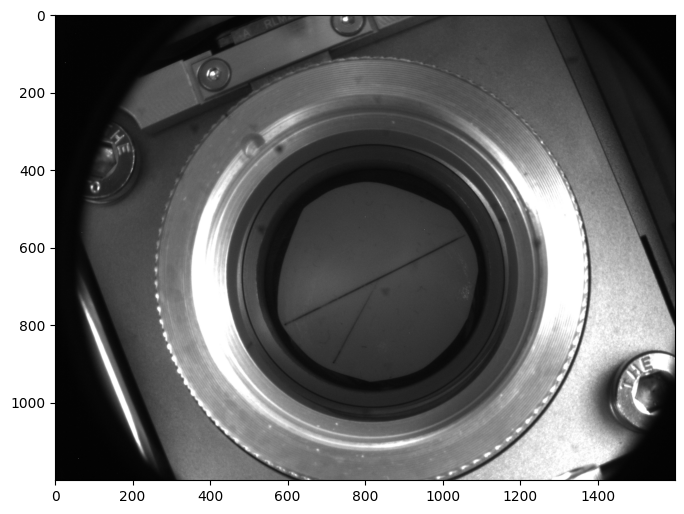

In [101]:
#add center and circle to the main image 


fig, ax = plt.subplots(figsize=(8, 8))
# Display the image using Matplotlib
plt.imshow(image_rgb)

for circle in vertical_circles:
    ax.scatter(circle[0][0], circle[0][1], color='red', s=100, label='Center')
    theta = np.linspace(0, 2*np.pi, 100)

    circle_x = circle[0][0] + circle[1] * np.cos(theta)
    circle_y = circle[0][1] + circle[1] * np.sin(theta)
    ax.plot(circle_x, circle_y, linewidth=2, linestyle='--', label='Fitted Circle')


In [102]:
circle_choice = vertical_circles


#scan inside of the cicle for points
#first lets look at horzional cross section
from matplotlib.pyplot import axis


image_height_px, image_width_px, _ = image_rgb.shape
image_demension = image_height_px 
step_size_px = 100

fig_main, ax_main = plt.subplots()

figs =[]
axes =[]
figure_count = 4
# Display the image using Matplotlib
ax_main.imshow(gray_image, cmap='gray')
ax_main.scatter(circle_choice[0][0][0], circle_choice[0][0][1], color='red', s=10, label='Center')

theta = np.linspace(0, 2*np.pi, 100)

cicle_x = circle_choice[0][0][0] + circle_choice[0][1] * np.cos(theta)
cicle_y = circle_choice[0][0][1] + circle_choice[0][1] * np.sin(theta)
ax_main.plot(cicle_x, cicle_y, color='red', linewidth=2, linestyle='--', label='Fitted Circle')
ax_main.grid()
# ax_main.set_xlim(201, 551)
# ax_main.set_ylim(501, 151)
axis = 'horizontal'  # 'horizontal' or 'vertical'
if axis == 'horizontal' or axis == 0:
    min_dimension_px = int(circle_choice[0][0][1] - circle_choice[0][1])
    max_dimension_px = int(circle_choice[0][0][1] + circle_choice[0][1])

    min_perpendicular_px = int(circle_choice[0][0][0] - circle_choice[0][1])
    max_perpendicular_px = int(circle_choice[0][0][0] + circle_choice[0][1])
else:
    min_dimension_px = int(circle_choice[0][0][0] - circle_choice[0][1])
    max_dimension_px = int(circle_choice[0][0][0] + circle_choice[0][1])

    min_perpendicular_px = int(circle_choice[0][0][1] - circle_choice[0][1])
    max_perpendicular_px = int(circle_choice[0][0][1] + circle_choice[0][1])


number_of_cross_sections = (max_dimension_px - min_dimension_px) // step_size_px
print(f"Min dimension px: {min_dimension_px}")
print(f"Max dimension px: {max_dimension_px}")
print(f"Number of cross sections to analyze: {number_of_cross_sections}")

#for line_count, cross_section_loc_px in  enumerate(np.arange(min_dimension_px, max_dimension_px + 1, step_size_px)):
for line_count, cross_section_loc_px in  enumerate(  [775]):
    if cross_section_loc_px < min_dimension_px or cross_section_loc_px > max_dimension_px:
        continue

    if line_count % figure_count == 0:
        fig, ax = plt.subplots(figsize=(8, 6))
        
        ax.grid()
        #ax.set_title(f"Cross section at {cross_section_loc_px}px")
        #ax.set_xlim(min_perpendicular_px, max_perpendicular_px)
        ax.set_xlabel("X (pixels)")
        

    print(f"Cross section at height: {cross_section_loc_px}")
    #filter out points that are outside of the circle
    filtered_cross_section = []
    filtered_locations = []

    if axis == 'horizontal' or axis == 0:
        
        # average the cross section over a few pixels to reduce noise
        cross_section_count=  0
        multi_cross_section = gray_image[:,cross_section_loc_px-cross_section_count:cross_section_loc_px+cross_section_count]

        if cross_section_count >0:
            full_cross_section = np.mean(multi_cross_section, axis=1)
        else:
            full_cross_section = gray_image[:, cross_section_loc_px]

        for x_px in range(image_width_px):
            dx = x_px - circle_choice[0][0][0]
            dy = cross_section_loc_px - circle_choice[0][0][1]
            distance = np.sqrt(dx**2 + dy**2)
            if distance <= circle_choice[0][1]:
                #add data to list
                filtered_cross_section.append(full_cross_section[x_px])
                filtered_locations.append(x_px)  
        if len(filtered_locations) == 0:
            continue
        ax_main.axhline(xmin = np.min(filtered_locations)/image_width_px,
                         xmax= np.max(filtered_locations)/image_width_px,
                        y=cross_section_loc_px, color='red', linestyle=':')
        


    else:
        full_cross_section = gray_image[cross_section_loc_px, :]

        
        for y_px in range(image_height_px):
            dx = cross_section_loc_px - circle_choice[0][0][0]
            dy = y_px - circle_choice[0][0][1]
            distance = np.sqrt(dx**2 + dy**2)
            if distance <= circle_choice[0][1]:
                #add data to list
                filtered_cross_section.append(full_cross_section[y_px])
                filtered_locations.append(y_px)

        
        if len(filtered_locations) == 0:
            continue
        ax_main.axvline(ymin = np.min(filtered_locations)/image_height_px,
                    ymax= np.max(filtered_locations)/image_height_px,
                x=cross_section_loc_px, color='red', linestyle=':')
    
    full_locs = np.arange(image_width_px)
    filtered_cross_section = np.array(filtered_cross_section)


    filtered_cross_section_adj = (np.max(filtered_cross_section) - filtered_cross_section)
    #smooth with savitzky golay filter
    smoothed_filtered_cross_section = scipy.signal.savgol_filter(filtered_cross_section_adj, window_length=50, polyorder=5) 

    peaks, properties = scipy.signal.find_peaks(filtered_cross_section_adj, height=10, distance=20,threshold=1, prominence=2, width=[5,10])

    print(f"Found peaks at: {peaks}")
    for key in properties.keys():
        print(f"  {key}: {properties[key]}")
    smoothed_peaks, smoothed_properties = scipy.signal.find_peaks(smoothed_filtered_cross_section, height=10, distance=20,threshold=10)
    #print(f"Found peaks at: {filtered_locations[peaks]} with heights {properties['peak_heights']}")
    #adjust locations of peaks ot match filtered locations
    filtered_peaks = np.array(peaks) #+ np.min(filtered_locations)

    filtered_max = np.max(filtered_cross_section)
    filtered_min = np.min(filtered_cross_section)
    ax.errorbar(x=filtered_locations, y=filtered_cross_section_adj, 
                label=f'Cross section at {cross_section_loc_px}px')
    ax.errorbar(x=filtered_locations, y=smoothed_filtered_cross_section, 
                label=f'Smoothed Cross section at {cross_section_loc_px}px')
    
    #print(f"Peak Conunt at {cross_section_loc_px}px: {len(filtered_peaks)}")
    #print(f"Filtered peaks: {filtered_peaks}")
    #print(f"Peak properties: {properties}")
    
    if len(peaks)>0:
        ax.errorbar(x=filtered_peaks+filtered_locations[0],
                    y=filtered_cross_section_adj[filtered_peaks], 
                yerr=5, fmt='o')#, label='Detected Peaks')
    
        ax_main.scatter(filtered_locations[0]+filtered_peaks, [cross_section_loc_px]*len(filtered_peaks), 
                 s=10)
        
    if len(smoothed_peaks) >0:
        ax.errorbar(x=smoothed_peaks+filtered_locations[0],
                    y=smoothed_filtered_cross_section[smoothed_peaks], 
                yerr=5, fmt='x', label='Detected Peaks')
    
        ax_main.scatter(filtered_locations[0]+smoothed_peaks, [cross_section_loc_px]*len(smoothed_peaks), 
                 s=20, marker='x', color='red')

    #find some peaks in the filtered cross section

    #peaks, properties = find_peaks(filtered_cross_section, height=(filtered_min + (filtered_max - filtered_min)*0.5))



    ax.legend()
    # ax.grid()
    # #ax.set_title(f"Cross section at {cross_section_loc_px}px")
    # ax.set_xlim(min_perpendicular_px, max_perpendicular_px)
    # ax.set_xlabel("X (pixels)")



    






NameError: name 'vertical_circles' is not defined

In [ ]:

filtered_cross_section_adj[peaks]



array([ 78,  91, 104, 101,  85,  74,  52, 218,   0], dtype=uint8)

In [ ]:
#interactive  plot to scan through a image and view a  cross section

array([ 77,  90, 103, 100,  84,  73,  51, 217, 255], dtype=uint8)

In [103]:
from ipywidgets import interact, IntSlider
import matplotlib.pyplot as plt
import numpy as np

def interactive_image_and_intensity(image, axis=0):
    """
    Interactive viewer: show image slice and intensity vs pixel for a given axis.
    image: 3D numpy array
    axis: 0=z, 1=y, 2=x
    """

    grey_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    n_slices = image.shape[axis]
    def plot(idx):
        if axis == 0:
            img_slice = image[idx, :, :]
            intensity = -(np.max(grey_image[idx, :]) - grey_image[idx,:])
            pixels = np.arange(len(intensity))
        elif axis == 1:
            img_slice = image[:, idx, :]
            intensity = grey_image[:, idx]
            pixels = np.arange(len(intensity))
        else:
            img_slice = image[:, :, idx]
            #intensity = img_slice.sum(axis=0)
            
            pixels = np.arange(img_slice.shape[1])
        fig, axs = plt.subplots(1, 2, figsize=(12, 5))
        axs[0].imshow(image, cmap='gray')
        axs[0].set_title(f'Image Slice (axis={axis}, idx={idx})')
        #axs[0].axis('off')
        axs[0].grid()
        if axis == 0:
            axs[0].axhline(y=idx, color='red', linestyle='--')
        elif axis == 1:
            axs[0].axvline(x=idx, color='red', linestyle='--')

        axs[1].plot(pixels, intensity)
        axs[1].set_title('Intensity vs Pixel')
        axs[1].set_xlabel('Pixel')
        axs[1].set_ylabel('Intensity')
        axs[1].grid()
        plt.tight_layout()
        #plt.show()
    interact(plot, idx=IntSlider(0, 0, n_slices-1, 1))

# Example usage:
# interactive_image_and_intensity(image, axis=0)


In [104]:

interactive_image_and_intensity(image_rgb, axis=0)

interactive(children=(IntSlider(value=0, description='idx', max=1199), Output()), _dom_classes=('widget-intera…

In [36]:
Vertical_limits = [350,1050]
Horizontal_limits = [400,1200]

In [37]:
random_x = 400
random_y = 450


Random Y: 810, Random X: 760
Left plateu at: 580
Error finding left plateu: 'right_edges'
Right plateu at: 1058
Error unsupported operand type(s) for +: 'NoneType' and 'int'



Error finding closest peak before center: attempt to get argmin of an empty sequence
Error finding vertical plateus: '>' not supported between instances of 'NoneType' and 'int'
bottom plateu at: 955
Error finding vertical good peak: unsupported operand type(s) for +: 'NoneType' and 'int'
good peaks
[]
No good horizontal peak found
No good vertical peak found
No good peaks found in both horizontal and vertical directions


KeyError: 'left_edges'

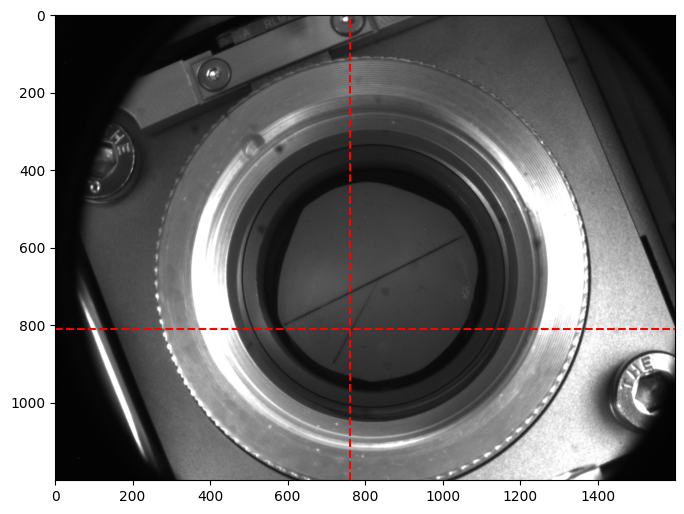

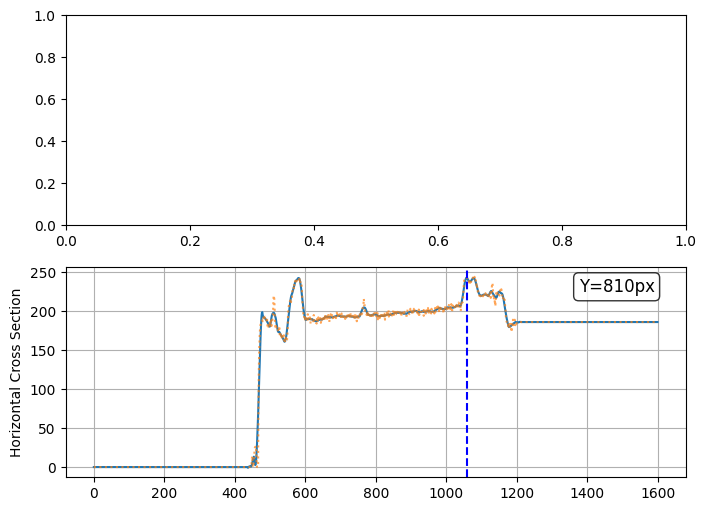

In [106]:
#for testing grab one horizotanl and one vertical cross seciton of the image

import random

if random_y < Vertical_limits[0] or random_x > Vertical_limits[1]:
    random_y = 400
if random_x < Horizontal_limits[0] or random_y > Horizontal_limits[1]:
    random_x = 450

random_x+=20
random_y+=20

# random_x = random.randint(Vertical_limits[0]+200, Vertical_limits[1]-150)
# random_y = random.randint(Horizontal_limits[0]+100, Horizontal_limits[1]-100)


#random_x = 580
# random_y = 610

fig1, ax1 = plt.subplots(figsize=(8, 8))
ax1.imshow(image_rgb)
ax1.axvline(x=random_x, color='red', linestyle='--')
ax1.axhline(y=random_y, color='red', linestyle='--')

fig, ax = plt.subplots(2,1,figsize=(8, 6))

fig_extra = [ax[1],ax[0]]
ax = fig_extra
print(f"Random Y: {random_y}, Random X: {random_x}")

horizontal_cross_section = gray_image[random_y,:]
vertical_cross_Section = gray_image[:,random_x]
image_height_px, image_width_px, _ = image_rgb.shape

#flip the the data to highlight darker points
horizontal_cross_section = np.max(horizontal_cross_section) - horizontal_cross_section
vertical_cross_Section = np.max(vertical_cross_Section) - vertical_cross_Section
untrimmed_horizontal = horizontal_cross_section
untrimmed_vertical = vertical_cross_Section

#clean up the edges, outside of the limits
horizontal_cross_section[:Horizontal_limits[0]] = horizontal_cross_section[Horizontal_limits[0]]
horizontal_cross_section[Horizontal_limits[1]:] = horizontal_cross_section[Horizontal_limits[1]]
vertical_cross_Section[:Vertical_limits[0]] = vertical_cross_Section[Vertical_limits[0]]
vertical_cross_Section[Vertical_limits[1]:] = vertical_cross_Section[Vertical_limits[1]]


raw_horizontal = horizontal_cross_section.copy()
raw_vertical   = vertical_cross_Section.copy()
smooth_horizontal = scipy.signal.savgol_filter(horizontal_cross_section, window_length=50, polyorder=3)
smooth_vertical   = scipy.signal.savgol_filter(vertical_cross_Section, window_length=50, polyorder=3)
#light smoothing with a savitzky golay filter
horizontal_cross_section = scipy.signal.savgol_filter(horizontal_cross_section, window_length=25, polyorder=3)
vertical_cross_Section = scipy.signal.savgol_filter(vertical_cross_Section, window_length=25, polyorder=3)

if 1:
    #Finding horizontal plateus
    try:
        left_plateu, left_plateu_properties = find_first_plateu(horizontal_cross_section,min_plateu_width=[1,320], threshold=35,bounds=Horizontal_limits,center = image_width_px//2)
        print(f"Left plateu at: {left_plateu}")
        left_plateu_right_base = left_plateu_properties['right_edges'] if left_plateu_properties is not None else None
        if left_plateu > image_width_px//2 or left_plateu < Horizontal_limits[0]:
            print("Left plateu out of bounds, ignoring")
            left_plateu = None
            left_plateu_properties = None
        
    except Exception as e:
        print("Error finding left plateu:", e)
        left_plateu = None
        left_plateu_properties = None

    try:
        right_plateu, right_plateu_properties = find_second_plateu(horizontal_cross_section,min_plateu_width=[1,320], threshold=35,bounds=Horizontal_limits,center = image_width_px//2)
        print(f"Right plateu at: {right_plateu}")
        if right_plateu < image_width_px//2 or right_plateu > Horizontal_limits[1]:
            print("Right plateu out of bounds, ignoring")
            right_plateu = None
            right_plateu_properties = None
    except Exception as e:
        print("Error finding right plateu:", e)
        right_plateu = None
        right_plateu_properties = None
    try:
        horiztonal_plateus = find_plateus(horizontal_cross_section, min_plateu_width=[1,320], threshold=30,bounds=Horizontal_limits)
    except Exception as e:
        print("Error finding horizontal plateus:", e)
        horiztonal_plateus = None




#finding a if there is a good peak in horizontal
try:
    horizontal_good_peak, horizontal_good_peaks_properties = find_best_peak(smooth_horizontal,#horizontal_cross_section,
                                                                        threshold = [3.3,100],
                                                                        width = [4,44],
                                                                        bounds=[left_plateu+15,right_plateu-15])


    ax[0].vlines(x=horizontal_good_peak, ymin = smooth_horizontal[horizontal_good_peak]-horizontal_good_peaks_properties['prominences'],
                ymax = smooth_horizontal[horizontal_good_peak], color='red', linestyle='--', label='Good Peaks')




    all_peaks, all_props = find_best_peak(raw_horizontal, threshold=[1,100],
                                      width=[1,100],
                                      bounds= [left_plateu+15,right_plateu-15])
except Exception as e:
    print("Error", e)

# print("good peaks")
# print(horizontal_good_peak)
# for key in horizontal_good_peaks_properties.keys():
#     print(f"{key}, {horizontal_good_peaks_properties[key]}")

# print(f"all peaks \n{all_peaks}")
# for key in all_props.keys():
#     print(key, all_props[key])


# for key in horizontal_good_peaks_properties:
#     print(f"{key}, {horizontal_good_peaks_properties[key]}")


print("\n\n")


#Finding vertical plateus
try:
    top_plateu, top_plateu_properties = find_first_plateu(vertical_cross_Section,   min_plateu_width=[1,200], threshold=30,bounds=Vertical_limits,center = image_height_px//2)
    
    if top_plateu > image_height_px//2 or top_plateu < Vertical_limits[0]:
        print("Top plateu out of bounds, ignoring")
        top_plateu = None
    else:
        print(f"Top plateu at: {top_plateu}")
except Exception as e:
    print("Error finding vertical plateus:", e)
    top_plateu = None


try:
    bottom_plateu, bottom_plateu_properties = find_second_plateu(vertical_cross_Section,   min_plateu_width=[1,200], threshold=36,bounds=Vertical_limits,center = image_height_px//2)
    
    if bottom_plateu < image_height_px//2 or bottom_plateu > Vertical_limits[1]:
        print("bottom plateu out of bounds, ignoring")
        bottom_plateu = None
    else:
        print(f"bottom plateu at: {bottom_plateu}")
except Exception as e:
    print("Error finding vertical plateus:", e)
    bottom_plateu = None


try:
    vertical_plateus = find_plateus(vertical_cross_Section  , min_plateu_width=[1,520], threshold=30,bounds=Vertical_limits)


except Exception as e:
    print("Error finding horizontal plateus:", e)
    vertical_plateus = None



#finding a if there is a good peak in vertical
try:
    vertical_good_peak, vertical_good_peaks_properties = find_best_peak(smooth_vertical,
                                                                        threshold = [3,100],
                                                                        width = [10,50],
                                                                        height=50,
                                                                        bounds=[top_plateu+5,bottom_plateu-5])
    

    v_all_peaks, v_all_props = find_best_peak(raw_vertical, threshold=[1,100],
                                      width=[1,100],
                                      bounds= [top_plateu+15,bottom_plateu-15])

    ax[1].vlines(x=vertical_good_peak, ymin = smooth_vertical[vertical_good_peak]-vertical_good_peaks_properties['prominences'],
                ymax = smooth_vertical[vertical_good_peak], color='red', linestyle='--', label='Good Peaks')


except Exception as e:
    print("Error finding vertical good peak:", e)
    vertical_good_peak = []
    vertical_good_peaks_properties = {}
    v_all_peaks = []
    v_all_props = {}
print("good peaks")
print(vertical_good_peak)
for key in vertical_good_peaks_properties:
    print(f"{key}, {vertical_good_peaks_properties[key]}")

# print("all peaks \n", all_peaks)
# for key in all_props.keys():
#     print(key, all_props[key])



good_hor_platues = right_plateu is not None and left_plateu is not None
good_vertical_platues = top_plateu != None and bottom_plateu is not None
#make sure vertical points are in horixontal bounds

if good_hor_platues :
    if random_x <left_plateu or random_x > right_plateu:
        print("vertical point is outside of bounds")
        print(f" lower limit {left_plateu}, upper limit {right_plateu}, value {random_x}")
        vertical_good_peak=[]
        vertical_good_peaks_properties=[]
if good_vertical_platues:
    #make sure horizontal points are in vertical bounds
    if random_y <top_plateu or random_y > bottom_plateu:
        print("horizontal point is outside of bounds")
        print(f" lower limit {top_plateu}, upper limit {bottom_plateu}, value {random_y}")
        horizontal_good_peak=[]
        horizontal_good_peaks_properties=[]
    
if len(horizontal_good_peak) == 0:
    print("No good horizontal peak found")
else:
    for peak in horizontal_good_peak:
        ax1.errorbar( x=peak,y=random_y,marker="x")
if len(vertical_good_peak) == 0:
    print("No good vertical peak found")
else:
    for peak in vertical_good_peak:
        ax1.errorbar(y=peak,x=random_x,fmt="",marker="x")
if len(horizontal_good_peak) ==0 and len(vertical_good_peak) ==0:
    print("No good peaks found in both horizontal and vertical directions")




# ax=[0,ax]
ax[0].plot(horizontal_cross_section)
ax[0].plot(untrimmed_horizontal,':',alpha=0.7)
#ax[0].errorbar(x=np.arange(len(raw_horizontal)),y=raw_horizontal, fmt=":")
ax[0].set_ylabel("Horizontal Cross Section")
ax[0].grid()
ax[0].text(0.95, 0.95, f'Y={random_y}px', transform=ax[0].transAxes, 
           fontsize=12, verticalalignment='top', horizontalalignment='right',
           bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
if left_plateu is not None:
    ax[0].axvline(x=left_plateu, color='red', linestyle='--', label='Left Plateu')
    ax[0].axvline(x=left_plateu_right_base, color='orange', linestyle='--', label='Left Plateu Right Base')
if right_plateu is not None:
    ax[0].axvline(x=right_plateu, color='blue', linestyle='--', label='Right Plateu')
    ax[0].axvline(x=right_plateu_properties['left_edges'], color='cyan', linestyle='--', label='Right Plateu Left Base')
if horizontal_good_peak is not None:
    if len(horizontal_good_peak) >0:
    
        ax[0].plot(horizontal_good_peak,horizontal_good_peaks_properties["peak_heights"],'x',markersize=10)


if horiztonal_plateus is not None:
    ax[0].plot(horiztonal_plateus[0], horiztonal_plateus[1]["peak_heights"], 'o', color='red', label='Plateus')

#average horizontal cross section for entries between the two plateus
avg_horizontal = np.mean(horizontal_cross_section[left_plateu:right_plateu])
print(f"Average horizontal cross section (above 0): {avg_horizontal:.2f}")

ax[0].axhline(y=avg_horizontal, color='green', linestyle='--', label='Average (above 0)')

ax[0].set_ylim(avg_horizontal-30, np.max(horizontal_cross_section))


ax[1].plot(vertical_cross_Section)
#ax[1].errorbar(x=np.arange(len(raw_vertical)),y=raw_vertical,fmt=":")
ax[1].plot(untrimmed_vertical,':',alpha=1)
ax[1].set_ylabel("Vertical Cross Section")
ax[1].grid()
ax[1].text(0.95, 0.95, f'X={random_x}px', transform=ax[1].transAxes, 
           fontsize=12, verticalalignment='top', horizontalalignment='right',
           bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

if top_plateu is not None:
    ax[1].axvline(x=top_plateu, color='red', linestyle='--', label='Top Plateu')

if bottom_plateu is not None:
    ax[1].axvline(x=bottom_plateu, color='blue', linestyle='--', label='Bottom Plateu')

if vertical_plateus is not None:
    ax[1].plot(vertical_plateus[0], vertical_plateus[1]["peak_heights"], 'o', color='red', label='Plateus')

if len(vertical_good_peak) > 0:
    ax[1].plot(vertical_good_peak,vertical_good_peaks_properties["peak_heights"],'x',markersize=10)

avg_vertical = np.mean(vertical_cross_Section[vertical_cross_Section>50])
print(f"Average vertical cross section (above 0): {avg_vertical:.2f}")
#ax[1].set_ylim(avg_vertical-30, np.min([avg_vertical+130,255]))






In [107]:
def find_best_peak(points, threshold = [5,10],width=[2,100],height=50, bounds=None):

    points = np.array(points)
    if threshold is np.number:
        threshold = [threshold, 1000]
    if width is np.number:
        width = [width,50]

    #set dataoutside of bounds to 0
    points[:bounds[0]] = points[bounds[0]]
    points[bounds[1]:] = points[bounds[1]]

    distance = (bounds[1]-bounds[0])/20

    peaks, peak_prioperties = scipy.signal.find_peaks(points,
                                                      height=height,
                                                       prominence=threshold,
                                                       width =width, distance=distance )


    return peaks, peak_prioperties



def find_first_plateu(points, min_plateu_width=[5], threshold=5,bounds=None, center=None):
    """
    Using Scipy find_peak to find the platue closest to the center on front side
    only look between the bounds if provided
    """

    points = np.array(points)
    
    # if bounds is not None:
    #     points = points[bounds[0]:bounds[1]]    
    # else:
    #     bounds = (0, len(points) - 1)

    if center is None:
        center = len(points)//2 + bounds[0]

    peaks, properties = scipy.signal.find_peaks(points, distance=5, height=10, width=min_plateu_width, prominence=threshold)

    if len(peaks) == 0:
        return None
    
    # #find the peak closest to the center of the data
    # print(f"Found peaks at: {peaks}")
    # for key in properties.keys():
    #     print(f"  {key}: {properties[key]}")


    # print(f"Bounds: {bounds}")
    # print(f"Points length: {len(points)}")
    
    # print(f"Center of data at: {center}")
    # #grab closest peak that is less than the center
    
    peaks_before_center = peaks[peaks < center]
    try:
        closest_peak = peaks_before_center[np.argmin(np.abs(peaks_before_center - center))]
    except Exception as e:
        print("Error finding closest peak before center:", e)
        return None, None

    closest_peak_property = {}
    for key in properties.keys():
        closest_peak_property[key] = properties[key][np.argmin(np.abs(peaks_before_center - center))]

    
    return closest_peak, closest_peak_property


def find_second_plateu(points, min_plateu_width=[5], threshold=5,bounds=None, center=None):
    """
    Using Scipy find_peak to find the platue closest to the center on back side
    only look between the bounds if provided
    """
    points = np.array(points)

    # if bounds is not None:
    #     points = points[bounds[0]:bounds[1]]    
    # else:
    #     bounds = (0, len(points) - 1)

    if center is None:
        center = len(points)//2 + bounds[0]
    
    peaks, properties = scipy.signal.find_peaks(points,distance =10, height=10,width=min_plateu_width, prominence=threshold)
    
    # #shift peaks back to original index if bounds were used
    # if bounds is not None:
    #     peaks = peaks + bounds[0]
    #     #also shift the properties by the same amount
    #     for key in properties.keys():
    #         if key == 'left_ips' or key == 'right_ips':
    #             properties[key] = properties[key] + bounds[0]
    #         if "bases" in key:
    #             properties[key] = properties[key] + bounds[0]

    if len(peaks) == 0:
        return None
    
    #find the peak closest to the center of the data
    # print(f"Found peaks at: {peaks}")
    # for key in properties.keys():
    #     print(f"  {key}: {properties[key]}")
    # print(f"Bounds: {bounds}")
    # print(f"Points length: {len(points)}")
    
    # print(f"Center of data at: {center}")
    #grab closest peak that is greater than the center
    peaks_after_center = peaks[peaks > center]
    
    # print("length of less then center",len(peaks[peaks<center]))

    # print(f"Peaks after center: {peaks_after_center}")
    try:
        closest_peak = peaks_after_center[np.argmin(np.abs(peaks_after_center - center))]
    except Exception as e:
        print("Error finding closest peak after center:", e)
        return None, None

    closest_peak_property = {}
    for key in properties.keys():
        closest_peak_property[key] = properties[key][np.argmin(np.abs(peaks_after_center - center)) +len(peaks[peaks<center])]

    return closest_peak, closest_peak_property



def find_plateus(points, min_plateu_width=[5],distance=10, height=10, threshold=5,bounds=None, center=None):
    """
    Using Scipy find_peak to find the platue closest to the center on front side
    only look between the bounds if provided
    """
    points = np.array(points)

    if center is None:
        center = len(points)//2 + bounds[0]
    
    peaks, properties = scipy.signal.find_peaks(points,distance =10, height=10,
                                                width=min_plateu_width, prominence=threshold)


    if len(peaks) == 0:
        return None

    # print(f"Found peaks at: {peaks}")
    # for key in properties.keys():
    #     print(f"  {key}: {properties[key]}")
    return peaks, properties


In [108]:
def grap_cicle_from_platues(image, resolution_px=10,limits_px=[(400,1200),(200,1100)], plot=True):
    """
    Using the plateus found in the horizontal and vertical cross sections
    to estimate the center and radius of the circle
    """
    horizontal_limits = limits_px[0]
    vertical_limits = limits_px[1]
    image_height_px, image_width_px, _ = image.shape
    #gray scale image if needed
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # grab all points via horizontal cross sections
    horizotal_peaks = []
    for y_px in range(vertical_limits[0], vertical_limits[1], resolution_px):
        #grab the horizontal cross section
        horizontal_cross_section = gray_image[y_px, :]
        #clean up the edges, outside of the limits set to 255
        horizontal_cross_section[:horizontal_limits[0]] = 255
        horizontal_cross_section[horizontal_limits[1]:] = 255
        #flip the the data to highlight darker points   
        horizontal_cross_section = np.max(horizontal_cross_section) - horizontal_cross_section
        #light smoothing with a savitzky golay filter
        horizontal_cross_section = scipy.signal.savgol_filter(horizontal_cross_section, window_length=25, polyorder=3)
        #grab the first and second plateus


        try:
            first_plateu, first_plateu_properties = find_first_plateu(horizontal_cross_section, min_plateu_width=[1,320], 
                                                                threshold=35,bounds=horizontal_limits,center = image_width_px//2)
        except Exception as e:
            print("Error finding first plateu:", e)
            first_plateu = None
            first_plateu_properties = None
        try:
            second_plateu, second_plateu_properties = find_second_plateu(horizontal_cross_section, min_plateu_width=[1,320], 
                                                                threshold=35,bounds=horizontal_limits,center = image_width_px//2)
        except Exception as e:
            print("Error finding second plateu:", e)
            second_plateu = None
            second_plateu_properties = None
        if first_plateu is not None:
            if first_plateu > image_width_px//2 or first_plateu < horizontal_limits[0]:
                first_plateu = None
                first_plateu_properties = None
        
        if second_plateu is not None:
            if second_plateu < image_width_px//2 or second_plateu > horizontal_limits[1]:
                second_plateu = None
                second_plateu_properties = None
        if first_plateu is not None:
            horizotal_peaks.append((first_plateu, y_px,first_plateu_properties))
        if second_plateu is not None:
            horizotal_peaks.append((second_plateu, y_px,second_plateu_properties))

    vertical_peaks = []
    for x_px in range(horizontal_limits[0], horizontal_limits[1], resolution_px):
        #grab the vertical cross section
        vertical_cross_section = gray_image[:, x_px]
        #clean up the edges, outside of the limits set to 255
        vertical_cross_section[:vertical_limits[0]] = 255
        vertical_cross_section[vertical_limits[1]:] = 255
        #flip the the data to highlight darker points
        vertical_cross_section = np.max(vertical_cross_section) - vertical_cross_section
        #light smoothing with a savitzky golay filter
        vertical_cross_section = scipy.signal.savgol_filter(vertical_cross_section, window_length=20, polyorder=3)
        #grab the first and second plateus
        first_plateu, first_plateu_properties = find_first_plateu(vertical_cross_section, min_plateu_width=[1,200], threshold=35,bounds=vertical_limits,center = image_height_px//2)
        if first_plateu is not None:
            if first_plateu > image_height_px//2 or first_plateu < vertical_limits[0]:
                first_plateu = None
                first_plateu_properties = None
        second_plateu, second_plateu_properties = find_second_plateu(vertical_cross_section, min_plateu_width=[1,200], threshold=35,bounds=vertical_limits,center = image_height_px//2)
        if second_plateu is not None:
            if second_plateu < image_height_px//2 or second_plateu > vertical_limits[1]:
                second_plateu = None
                second_plateu_properties = None
        if first_plateu is not None:
            vertical_peaks.append((x_px, first_plateu,first_plateu_properties))
        if second_plateu is not None:
            vertical_peaks.append((x_px, second_plateu,second_plateu_properties))
    

        
    if plot:
        fig, ax = plt.subplots(figsize=(8, 8))
        # Display the image using Matplotlib
        ax.imshow(image, cmap='gray')
        for peak in horizotal_peaks:
            ax.scatter(peak[0], peak[1], color='red', s=10)
        for peak in vertical_peaks:
            ax.scatter(peak[0], peak[1], color='blue', s=10)
        ax.set_xlim(0, image_width_px)
        ax.set_ylim(image_height_px, 0)
        ax.set_title("Detected Plateu Points")
        ax.grid()
        

    return horizotal_peaks, vertical_peaks


Error finding closest peak before center: attempt to get argmin of an empty sequence
Error finding closest peak before center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty sequence
Error finding closest peak after center: attempt to get argmin of an empty

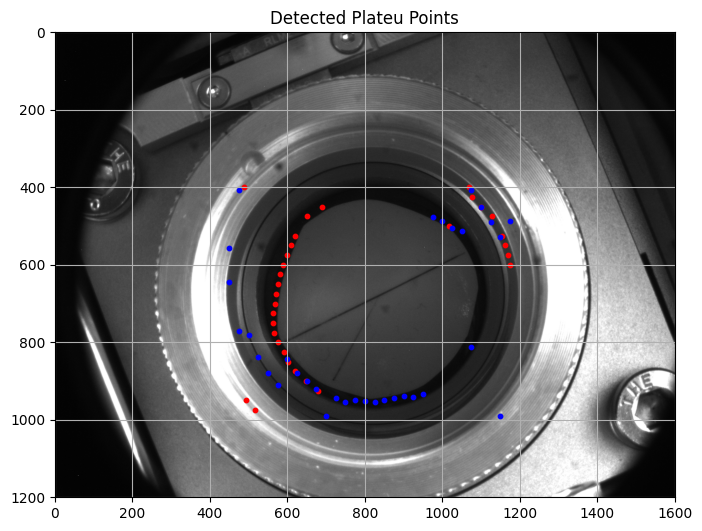

In [109]:
Vertical_limits = [400,1000]
Horizontal_limits = [450,1200]
points= grap_cicle_from_platues(image_rgb, resolution_px=25,limits_px=[Horizontal_limits,Vertical_limits], plot=True)



In [42]:
np.array(points[0])[:,0]

array([np.int64(1047), np.int64(1078), np.int64(683), np.int64(1102),
       np.int64(665), np.int64(1121), np.int64(1018), np.int64(619),
       np.int64(1046), np.int64(610), np.int64(1064), np.int64(600),
       np.int64(1079), np.int64(590), np.int64(996), np.int64(582),
       np.int64(946), np.int64(575), np.int64(897), np.int64(570),
       np.int64(847), np.int64(795), np.int64(1104), np.int64(745),
       np.int64(1102), np.int64(695), np.int64(1098), np.int64(644),
       np.int64(1089), np.int64(574), np.int64(592), np.int64(602),
       np.int64(620), np.int64(647), np.int64(1180), np.int64(683),
       np.int64(623), np.int64(1064), np.int64(665), np.int64(1035)],
      dtype=object)

In [110]:
center_guess=(800, 700)
#center_guess=(1400,2500)

horizontal_groups = group_points_by_radius(np.array(points[0]), center_guess=center_guess, tolerance=120)
# vertical_groups = group_points_by_radius(v_narrow_points, center_guess=center_guess, tolerance=35)
# both_points = np.vstack((points, v_points))
# all_groups = group_points_by_radius(both_points, center_guess=center_guess, tolerance=120)

NameError: name 'group_points_by_radius' is not defined

In [111]:
Vertical_limits = [400,1050]
Horizontal_limits = [400,1200]

In [112]:
image_rgb = cv2.imread('C:\\Users\\Jason.Bane\\Documents\\Nautilus\\DOE_stage\\code_trials\\images\\Image00018.BMP')

In [113]:
image=  image_rgb
image_height_px, image_width_px, _ = image.shape
#gray scale image if needed
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [149]:
random_x = 400
random_y = 450


Random Y: 470, Random X: 420
Error finding top plateus: cannot unpack non-iterable NoneType object
Error finding bottom plateus: cannot unpack non-iterable NoneType object
Vertical plateus found: (array([ 322,  416, 1065]), {'peak_heights': array([42.86606335, 20.12307692, 92.50226244]), 'prominences': array([11.37285068, 22.1438914 , 96.72217195]), 'left_bases': array([ 299,  407, 1057]), 'right_bases': array([1057, 1057, 1074]), 'widths': array([26.60891198,  9.02593419,  8.16129401]), 'width_heights': array([37.17963801,  9.05113122, 44.14117647]), 'left_ips': array([ 306.36062207,  411.20290368, 1061.16067272]), 'right_ips': array([ 332.96953405,  420.22883788, 1069.32196673])})
  peak_heights: [42.86606335 20.12307692 92.50226244]
  prominences: [11.37285068 22.1438914  96.72217195]
  left_bases: [ 299  407 1057]
  right_bases: [1057 1057 1074]
  widths: [26.60891198  9.02593419  8.16129401]
  width_heights: [37.17963801  9.05113122 44.14117647]
  left_ips: [ 306.36062207  411.202

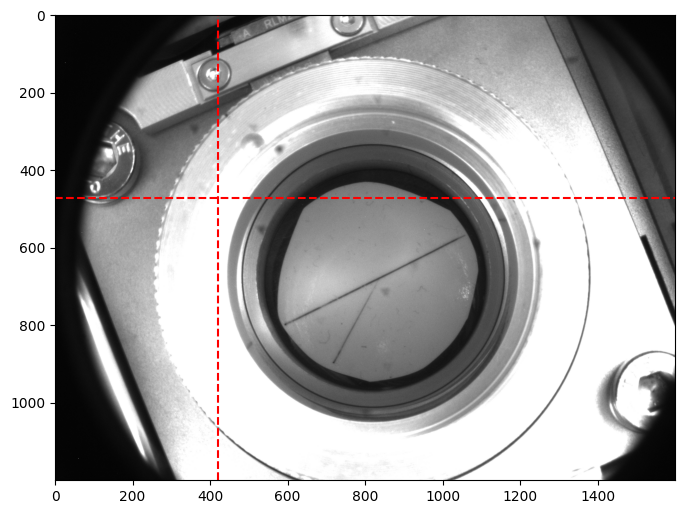

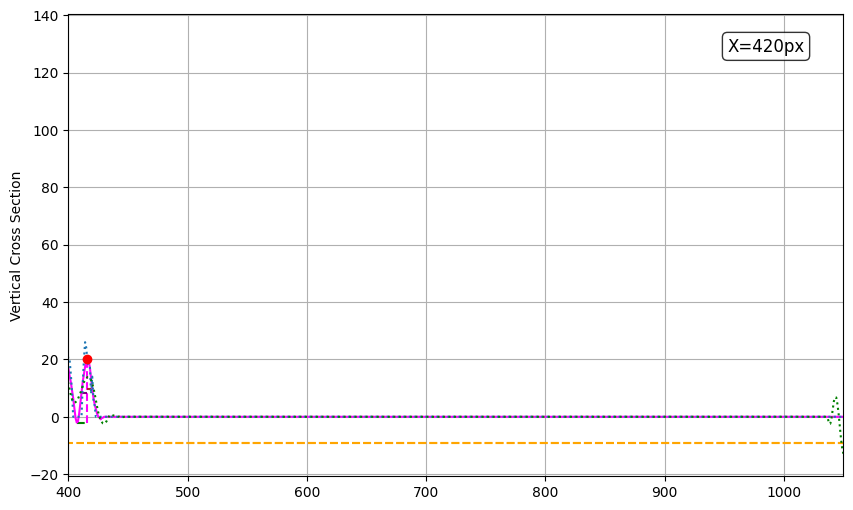

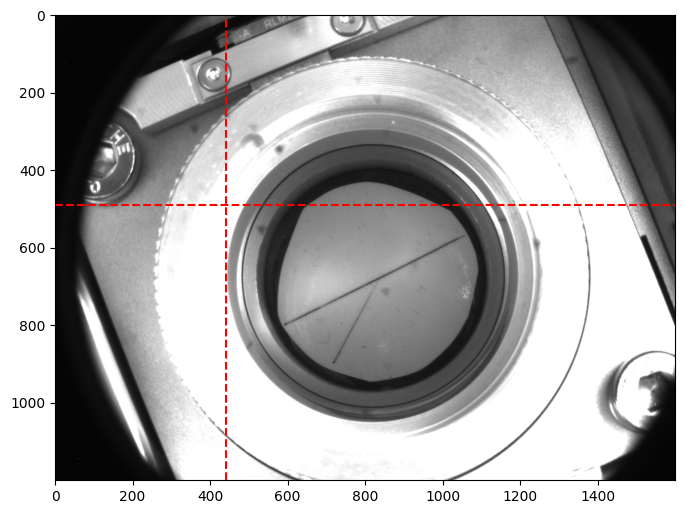

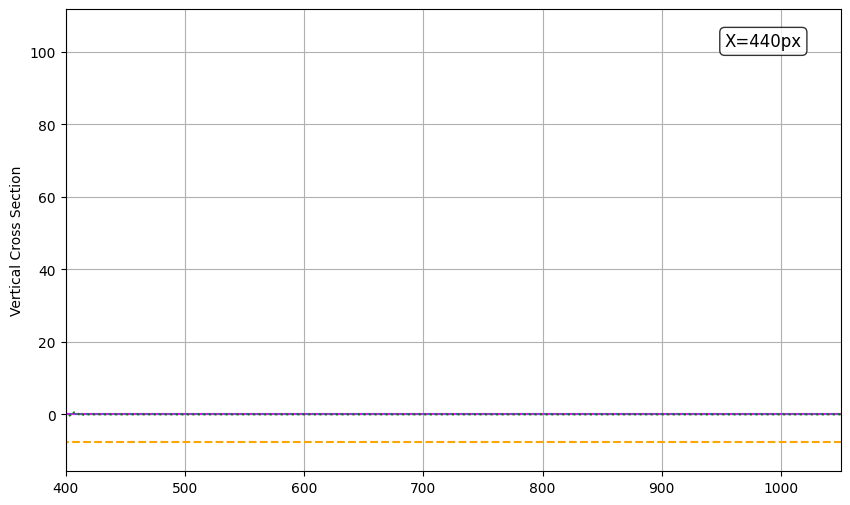

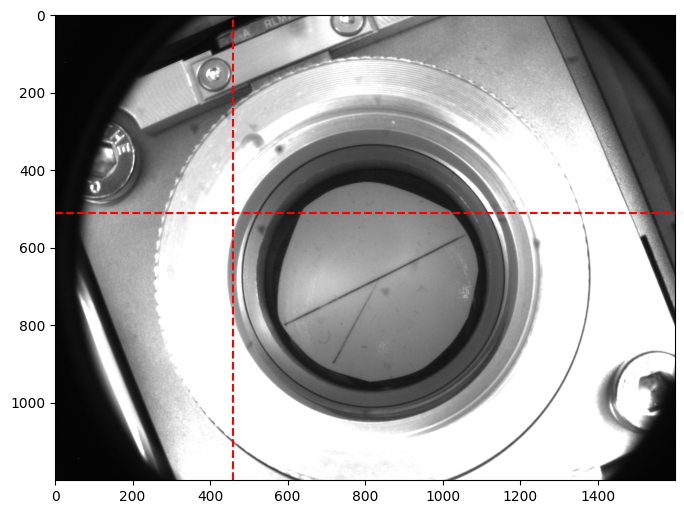

...

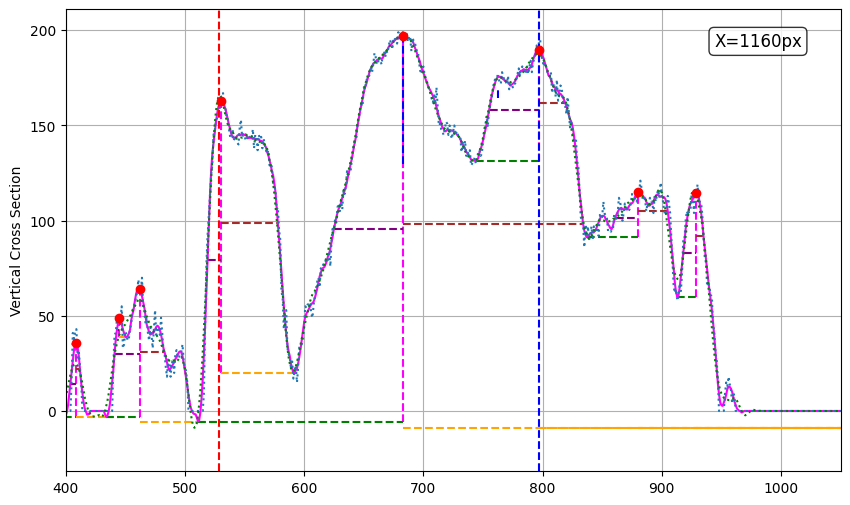

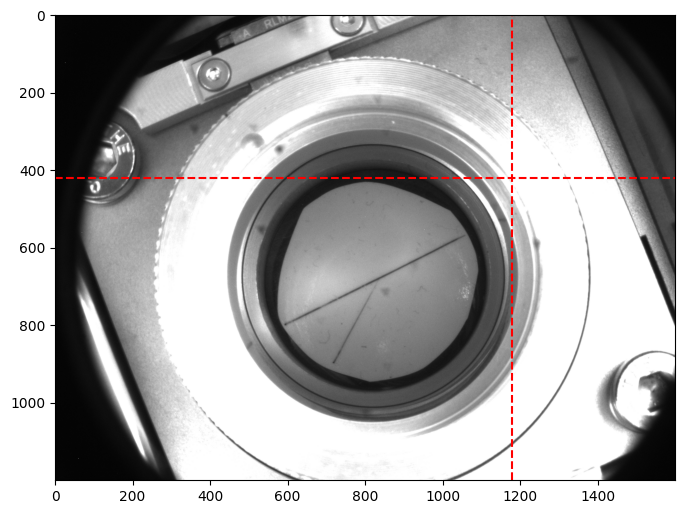

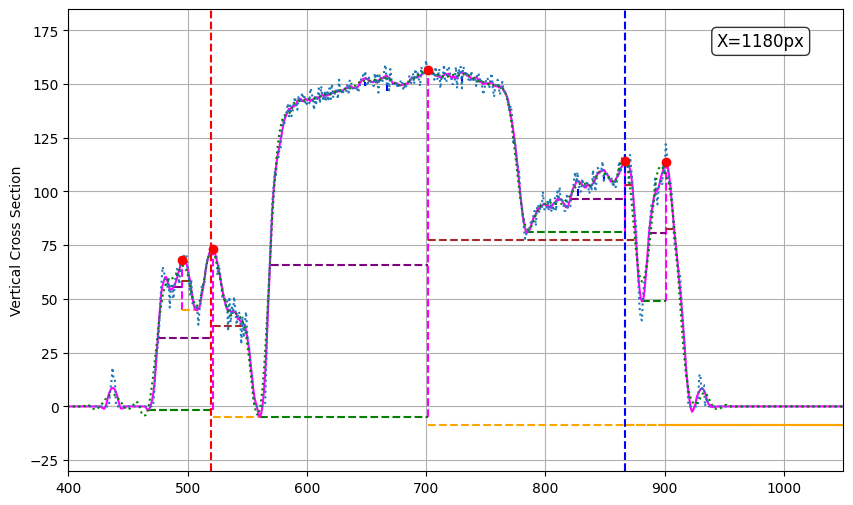

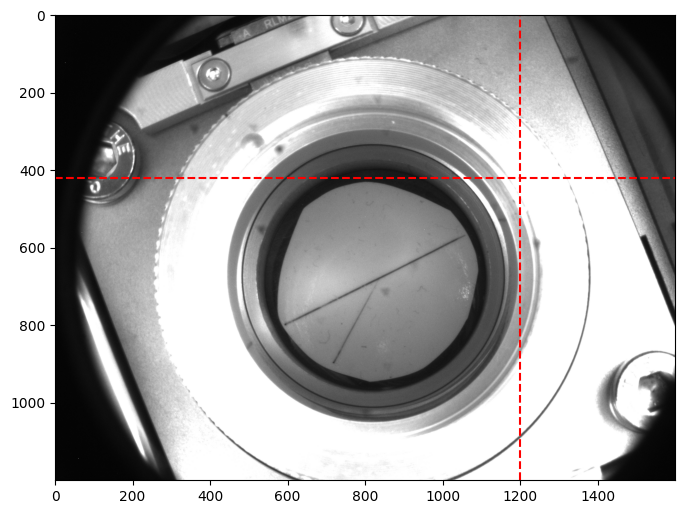

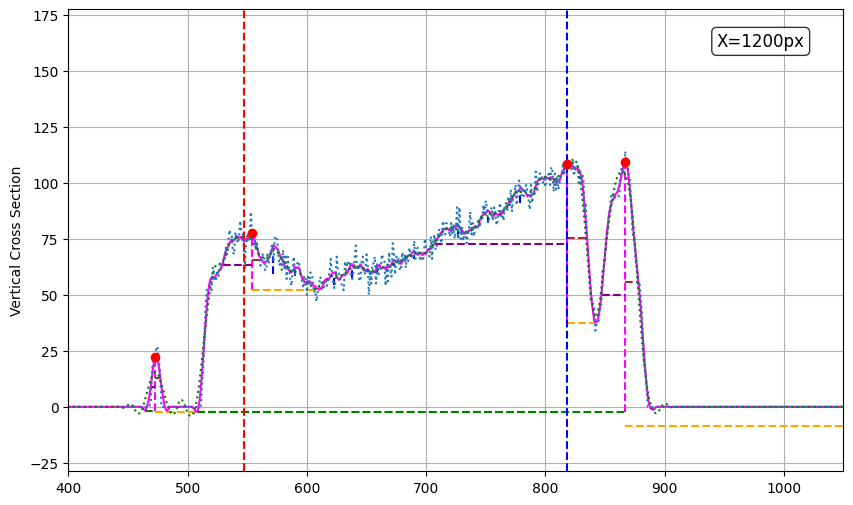

In [150]:
#for testing grab one horizotanl and one vertical cross seciton of the image


the_peaks = []

import random
for i in np.arange(40):
    if random_y < Vertical_limits[0] or random_x > Vertical_limits[1]:
        random_y = 400
    if random_x < Horizontal_limits[0] or random_y > Horizontal_limits[1]:
        random_x = 450

    random_x+=20
    random_y+=20

    # random_x = random.randint(Vertical_limits[0]+200, Vertical_limits[1]-150)
    # random_y = random.randint(Horizontal_limits[0]+100, Horizontal_limits[1]-100)

    # random_x = 710
    # random_y = 610

    fig1, ax1 = plt.subplots(figsize=(8, 8))
    ax1.imshow(image_rgb)
    ax1.axvline(x=random_x, color='red', linestyle='--')
    ax1.axhline(y=random_y, color='red', linestyle='--')

    fig, ax = plt.subplots(1,1,figsize=(10, 6))

    fig_extra = [0,ax]#,ax[0]]
    ax = fig_extra
    print(f"Random Y: {random_y}, Random X: {random_x}")

    horizontal_cross_section = gray_image[random_y,:].copy()
    vertical_cross_Section = gray_image[:,random_x].copy()
    image_height_px, image_width_px, _ = image_rgb.shape

    #flip the the data to highlight darker points
    horizontal_cross_section = np.max(horizontal_cross_section) - horizontal_cross_section
    vertical_cross_Section = np.max(vertical_cross_Section) - vertical_cross_Section
    untrimmed_horizontal = horizontal_cross_section
    untrimmed_vertical = vertical_cross_Section

    #clean up the edges, outside of the limits
    horizontal_cross_section[:Horizontal_limits[0]-100] = horizontal_cross_section[Horizontal_limits[0]-100]
    horizontal_cross_section[Horizontal_limits[1]+100:] = horizontal_cross_section[Horizontal_limits[1]+100]
    vertical_cross_Section[:Vertical_limits[0]-100] = vertical_cross_Section[Vertical_limits[0]-100]
    vertical_cross_Section[Vertical_limits[1]+100:] = vertical_cross_Section[Vertical_limits[1]+100]


    raw_horizontal = horizontal_cross_section.copy()
    raw_vertical   = vertical_cross_Section.copy()
    smooth_horizontal = scipy.signal.savgol_filter(horizontal_cross_section, window_length=50, polyorder=3)
    smooth_vertical   = scipy.signal.savgol_filter(vertical_cross_Section, window_length=50, polyorder=3)
    #light smoothing with a savitzky golay filter
    horizontal_cross_section = scipy.signal.savgol_filter(horizontal_cross_section, window_length=15, polyorder=3)
    vertical_cross_Section = scipy.signal.savgol_filter(vertical_cross_Section, window_length=15, polyorder=3)

    hor_plat_smooth = scipy.signal.savgol_filter(raw_horizontal, window_length=50, polyorder=7)
    ver_plat_smooth = scipy.signal.savgol_filter(raw_vertical, window_length=50, polyorder=7)
    if 0:
        #Finding horizontal plateus
        try:
            left_plateu, left_plateu_properties = find_first_plateu(horizontal_cross_section,min_plateu_width=[1,320], threshold=35,bounds=Horizontal_limits,center = image_width_px//2)
            print(f"Left plateu at: {left_plateu}")
            left_plateu_right_base = left_plateu_properties['right_edges'] if left_plateu_properties is not None else None
            if left_plateu > image_width_px//2 or left_plateu < Horizontal_limits[0]:
                print("Left plateu out of bounds, ignoring")
                left_plateu = None
                left_plateu_properties = None
            
        except Exception as e:
            print("Error finding left plateu:", e)
            left_plateu = None
            left_plateu_properties = None

        try:
            right_plateu, right_plateu_properties = find_second_plateu(horizontal_cross_section,min_plateu_width=[1,320], threshold=35,bounds=Horizontal_limits,center = image_width_px//2)
            print(f"Right plateu at: {right_plateu}")
            if right_plateu < image_width_px//2 or right_plateu > Horizontal_limits[1]:
                print("Right plateu out of bounds, ignoring")
                right_plateu = None
                right_plateu_properties = None
        except Exception as e:
            print("Error finding right plateu:", e)
            right_plateu = None
            right_plateu_properties = None
        try:
            horiztonal_plateus = find_plateus(horizontal_cross_section, min_plateu_width=[1,320], threshold=30,bounds=Horizontal_limits)
        except Exception as e:
            print("Error finding horizontal plateus:", e)
            horiztonal_plateus = None


        #finding a if there is a good peak in horizontal
        try:
            horizontal_good_peak, horizontal_good_peaks_properties = find_best_peak(smooth_horizontal,#horizontal_cross_section,
                                                                                threshold = [3.3,100],
                                                                                width = [4,44],
                                                                                bounds=[left_plateu+15,right_plateu-15])


            ax[0].vlines(x=horizontal_good_peak, ymin = smooth_horizontal[horizontal_good_peak]-horizontal_good_peaks_properties['prominences'],
                        ymax = smooth_horizontal[horizontal_good_peak], color='red', linestyle='--', label='Good Peaks')




            all_peaks, all_props = find_best_peak(raw_horizontal, threshold=[1,100],
                                            width=[1,100],
                                            bounds= [left_plateu+15,right_plateu-15])
        except Exception as e:
            print("Error", e)

        # print("good peaks")
        # print(horizontal_good_peak)
        # for key in horizontal_good_peaks_properties.keys():
        #     print(f"{key}, {horizontal_good_peaks_properties[key]}")

        # print(f"all peaks \n{all_peaks}")
        # for key in all_props.keys():
        #     print(key, all_props[key])


        # for key in horizontal_good_peaks_properties:
        #     print(f"{key}, {horizontal_good_peaks_properties[key]}")


        print("\n\n")

    if 1:
        #Finding vertical plateus
        try:
            top_plateu, top_plateu_properties = find_first_plateu(ver_plat_smooth,  
                                                                min_plateu_width=[20,200],
                                                                threshold=20,
                                                                bounds=Vertical_limits,
                                                                center = image_height_px//2)
            
            if top_plateu > image_height_px//2 or top_plateu < Vertical_limits[0]:
                print("Top plateu out of bounds, ignoring")
                top_plateu = None
            else:
                print(f"Top plateu at: {top_plateu}")
        except Exception as e:
            print("Error finding top plateus:", e)
            top_plateu = None


        try:
            bottom_plateu, bottom_plateu_properties = find_second_plateu(vertical_cross_Section, 
                                                                        min_plateu_width=[20,200],
                                                                        threshold=20,
                                                                        bounds=Vertical_limits,
                                                                        center = image_height_px//2)
            
            if bottom_plateu < image_height_px//2 or bottom_plateu > Vertical_limits[1]:
                print("bottom plateu out of bounds, ignoring")
                bottom_plateu = None
            else:
                print(f"bottom plateu at: {bottom_plateu}")
        except Exception as e:
            print("Error finding bottom plateus:", e)
            bottom_plateu = None

        # if top_plateu is  None or bottom_plateu is None:
        #     print("One of the vertical plateus is None, skipping vertical peak finding")
        #     break
        # if  np.abs(top_plateu - bottom_plateu) < 75:
        #     print("Vertical plateus too close together, skipping vertical peak finding")
        #     break

        try:
            vertical_plateus = find_plateus(vertical_cross_Section  ,
                                            min_plateu_width=[1,520], 
                                            threshold=10,
                                            bounds=Vertical_limits)

            ax[1].vlines(x=vertical_plateus[0], ymin = vertical_cross_Section[vertical_plateus[0]]-vertical_plateus[1]['prominences'],
                        ymax = vertical_cross_Section[vertical_plateus[0]], color='magenta', linestyle='--', label='Plateus')


            print("Vertical plateus found:", vertical_plateus)
            for key in vertical_plateus[1].keys():
                print(f"  {key}: {vertical_plateus[1][key]}")

            #check the separation of the peak and ips
            for i, peak in enumerate(vertical_plateus[0]):
                left_base = vertical_plateus[1]['left_bases'][i]
                right_base = vertical_plateus[1]['right_bases'][i]
                left_ips = vertical_plateus[1]['left_ips'][i]
                right_ips = vertical_plateus[1]['right_ips'][i]
                print(f"Peak {peak}: left_base={left_base}, right_base={right_base}, left_ips={left_ips}, right_ips={right_ips}")
                ax[1].hlines(y=vertical_cross_Section[left_base], xmin=left_base, xmax=peak, color='green', linestyle='--', label='Left Base')
                ax[1].hlines(y=vertical_cross_Section[right_base], xmin=peak, xmax=right_base, color='orange', linestyle='--', label='Right Base')
                ax[1].hlines(y=vertical_cross_Section[int(left_ips)], xmin=left_ips, xmax=peak, color='purple', linestyle='--', label='Left IPS')
                ax[1].hlines(y=vertical_cross_Section[int(right_ips)], xmin=peak, xmax=right_ips, color='brown', linestyle='--', label='Right IPS')
                # threshild from both ips
                left_threshold = vertical_cross_Section[vertical_plateus[0][i]] - vertical_cross_Section[int(left_ips)]
                right_threshold = vertical_cross_Section[vertical_plateus[0][i]] - vertical_cross_Section[int(right_ips)]

                print(f"  Thresholds: left={left_threshold}, right={right_threshold}")




        except Exception as e:
            print("Error finding vertical plateus:", e)
            vertical_plateus = None



        #finding a if there is a good peak in vertical
        try:
            vertical_good_peak, vertical_good_peaks_properties = find_best_peak(vertical_cross_Section,
                                                                                threshold = [15,100],
                                                                                width = [5,50],
                                                                                height=10,
                                                                                bounds=[top_plateu+5,bottom_plateu-5])
            

            v_all_peaks, v_all_props = find_best_peak(vertical_cross_Section, 
                                            threshold=[1,100],
                                            width=[1,100],
                                            height=10,
                                            bounds= [top_plateu+15,bottom_plateu-15])

            ax[1].vlines(x=vertical_good_peak, ymin = smooth_vertical[vertical_good_peak]-vertical_good_peaks_properties['prominences'],
                        ymax = smooth_vertical[vertical_good_peak], color='red', linestyle='--', label='Good Peaks')

            ax[1].vlines(x=v_all_peaks, ymin = smooth_vertical[v_all_peaks]-v_all_props['prominences'],
                        ymax = smooth_vertical[v_all_peaks], color='blue', linestyle='--', label='All Peaks')


            #only best two peaks from vertical_good_peaks 
            if vertical_good_peak is not None:
                if len(vertical_good_peak) > 2:
                    sorted_indices = np.argsort(vertical_good_peaks_properties['prominences'])[::-1]
                    top_two_indices = sorted_indices[:2]
                    vertical_selected_peak = vertical_good_peak[top_two_indices]
                    vertical_selected_peaks_properties = {key: np.array(value)[top_two_indices] for key, value in vertical_good_peaks_properties.items()}
                else:
                    vertical_selected_peak = vertical_good_peak
                    vertical_selected_peaks_properties = vertical_good_peaks_properties

        except Exception as e:
            print("Error finding vertical good peak:", e)
            vertical_good_peak = []
            vertical_good_peaks_properties = {}
            v_all_peaks = []
            v_all_props = {}

        print("good peaks")
        print(vertical_good_peak)
        for key in vertical_good_peaks_properties:
            print(f"{key}, {vertical_good_peaks_properties[key]}")

        print("all peaks \n", v_all_peaks)
        for key in v_all_props.keys():
            print(key, v_all_props[key])

    right_plateu=1100
    left_plateu=511

    good_hor_platues = right_plateu is not None and left_plateu is not None
    good_vertical_platues = top_plateu != None and bottom_plateu is not None
    #make sure vertical points are in horixontal bounds

    if good_hor_platues :
        if random_x <left_plateu or random_x > right_plateu:
            print("vertical point is outside of bounds")
            print(f" lower limit {left_plateu}, upper limit {right_plateu}, value {random_x}")
            vertical_good_peak=[]
            vertical_good_peaks_properties=[]
    if good_vertical_platues:
        #make sure horizontal points are in vertical bounds
        if random_y <top_plateu or random_y > bottom_plateu:
            print("horizontal point is outside of bounds")
            print(f" lower limit {top_plateu}, upper limit {bottom_plateu}, value {random_y}")
            horizontal_good_peak=[]
            horizontal_good_peaks_properties=[]
        
    if len(horizontal_good_peak) == 0:
        print("No good horizontal peak found")
    else:
        for peak in horizontal_good_peak:
            ax1.errorbar( x=peak,y=random_y,marker="x")
    if len(vertical_good_peak) == 0:
        print("No good vertical peak found")
    else:
        for peak in vertical_selected_peak:
            ax1.errorbar(y=peak,x=random_x,fmt="",marker="x")
    if len(horizontal_good_peak) ==0 and len(vertical_good_peak) ==0:
        print("No good peaks found in both horizontal and vertical directions")


    #plotting horizontal cross section
    if 0:
        # ax=[0,ax]
        ax[0].plot(horizontal_cross_section)
        ax[0].plot(untrimmed_horizontal,':',alpha=0.7)
        
        #ax[0].errorbar(x=np.arange(len(raw_horizontal)),y=raw_horizontal, fmt=":")
        ax[0].set_ylabel("Horizontal Cross Section")
        ax[0].grid()
        ax[0].text(0.95, 0.95, f'Y={random_y}px', transform=ax[0].transAxes, 
                fontsize=12, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        if left_plateu is not None:
            ax[0].axvline(x=left_plateu, color='red', linestyle='--', label='Left Plateu')
            ax[0].axvline(x=left_plateu_right_base, color='orange', linestyle='--', label='Left Plateu Right Base')
        if right_plateu is not None:
            ax[0].axvline(x=right_plateu, color='blue', linestyle='--', label='Right Plateu')
            ax[0].axvline(x=right_plateu_properties['left_edges'], color='cyan', linestyle='--', label='Right Plateu Left Base')
        if horizontal_good_peak is not None:
            if len(horizontal_good_peak) >0:
            
                ax[0].plot(horizontal_good_peak,horizontal_good_peaks_properties["peak_heights"],'x',markersize=10)


        if horiztonal_plateus is not None:
            ax[0].plot(horiztonal_plateus[0], horiztonal_plateus[1]["peak_heights"], 'o', color='red', label='Plateus')

        #average horizontal cross section for entries between the two plateus
        avg_horizontal = np.mean(horizontal_cross_section[left_plateu:right_plateu])
        print(f"Average horizontal cross section (above 0): {avg_horizontal:.2f}")

        ax[0].axhline(y=avg_horizontal, color='green', linestyle='--', label='Average (above 0)')

        ax[0].set_ylim(avg_horizontal-30, np.max(horizontal_cross_section))

    #plotting vertical cross section
    if 1:
        ax[1].plot(vertical_cross_Section, color="magenta")
        #ax[1].errorbar(x=np.arange(len(raw_vertical)),y=raw_vertical,fmt=":")
        ax[1].plot(untrimmed_vertical,':',alpha=1)
        #ax[1].plot(smooth_vertical,':',alpha=0.7)
        ax[1].plot(ver_plat_smooth,':',color="green",alpha=1)
        ax[1].set_ylabel("Vertical Cross Section")
        ax[1].grid()
        ax[1].text(0.95, 0.95, f'X={random_x}px', transform=ax[1].transAxes, 
                fontsize=12, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

        if top_plateu is not None:
            ax[1].axvline(x=top_plateu, color='red', linestyle='--', label='Top Plateu')

        if bottom_plateu is not None:
            ax[1].axvline(x=bottom_plateu, color='blue', linestyle='--', label='Bottom Plateu')

        if vertical_plateus is not None:
            ax[1].plot(vertical_plateus[0], vertical_plateus[1]["peak_heights"], 'o', color='red', label='Plateus')

        if len(vertical_good_peak) > 0:
            ax[1].plot(vertical_good_peak,vertical_good_peaks_properties["peak_heights"],'x',markersize=10)

        avg_vertical = np.mean(vertical_cross_Section[top_plateu:bottom_plateu])
        print(f"Average vertical cross section (above 0): {avg_vertical:.2f}")


        ax[1].set_xlim(Vertical_limits[0], Vertical_limits[1])
        #ax[1].set_ylim(avg_vertical-50, avg_vertical+60)
        if len(vertical_selected_peak) >0:
            for sel_peak in vertical_selected_peak:
                the_peaks.append((random_x,sel_peak))


In [151]:
the_peaks = np.array(the_peaks)
the_peaks

array([[ 520,  521],
       [ 540,  521],
       [ 560,  521],
       [ 580,  521],
       [ 600,  796],
       [ 620,  787],
       [ 640,  787],
       [ 660,  767],
       [ 680,  757],
       [ 700,  748],
       [ 720,  738],
       [ 720,  895],
       [ 740,  728],
       [ 740,  859],
       [ 760,  717],
       [ 760,  822],
       [ 780,  708],
       [ 780,  784],
       [ 800,  697],
       [ 800,  748],
       [ 820,  688],
       [ 840,  678],
       [ 860,  668],
       [ 860,  711],
       [ 880,  658],
       [ 900,  648],
       [ 920,  639],
       [ 940,  629],
       [ 960,  618],
       [ 980,  608],
       [1000,  598],
       [1020,  588],
       [1020,  986],
       [1040,  588],
       [1040,  986],
       [1060,  661],
       [1080,  661],
       [1100,  661],
       [1120,  832],
       [1120,  520],
       [1140,  566],
       [1140,  786]])

In [152]:
the_peaks[:,0]

array([ 520,  540,  560,  580,  600,  620,  640,  660,  680,  700,  720,
        720,  740,  740,  760,  760,  780,  780,  800,  800,  820,  840,
        860,  860,  880,  900,  920,  940,  960,  980, 1000, 1020, 1020,
       1040, 1040, 1060, 1080, 1100, 1120, 1120, 1140, 1140])

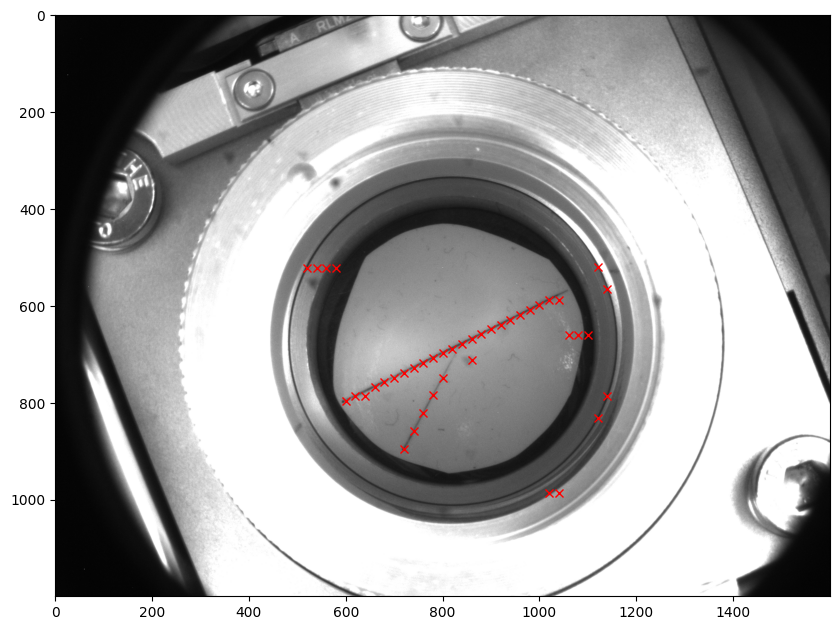

In [153]:
fig, ax = plt.subplots(figsize=(10,8))


ax.imshow(image_rgb)

ax.plot(the_peaks[:,0],the_peaks[:,1],marker="x",linestyle="None",color="red")

In [ ]:
# plotting horizontal cross section

In [ ]:
#  attempt to fit two lines to the_peaks

In [82]:
Vertical_limits=[200,1100]

In [135]:
gray_image = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2GRAY)

Found peaks at: [ 255  424  737  897  947  997 1020]
Peak properties:
  peak_heights: [106. 235. 163. 196. 233. 213. 198.]
  prominences: [ 83. 235.  80.  57. 183.  51.  33.]
  left_bases: [ 208  208  693  693  693  961 1015]
  right_bases: [ 268 1041  745  909 1041 1041 1041]
  widths: [ 20.15625    194.45634921   5.65795207   7.62847222 124.36363636
   5.6875      10.11111111]
  width_heights: [ 64.5 117.5 123.  167.5 141.5 187.5 181.5]
  left_ips: [ 245.34375     310.47222222  734.51851852  891.27777778  910.13636364
  994.59375    1016.83333333]
  right_ips: [ 265.5         504.92857143  740.17647059  898.90625    1034.5
 1000.28125    1026.94444444]
Peak at 255 has width 20 (left_ips: 245, right_ips: 265)
Peak at 424 has width 194 (left_ips: 310, right_ips: 504)
Peak at 737 has width 6 (left_ips: 734, right_ips: 740)
Peak at 897 has width 7 (left_ips: 891, right_ips: 898)
Peak at 947 has width 124 (left_ips: 910, right_ips: 1034)
Peak at 997 has width 6 (left_ips: 994, right_ips: 

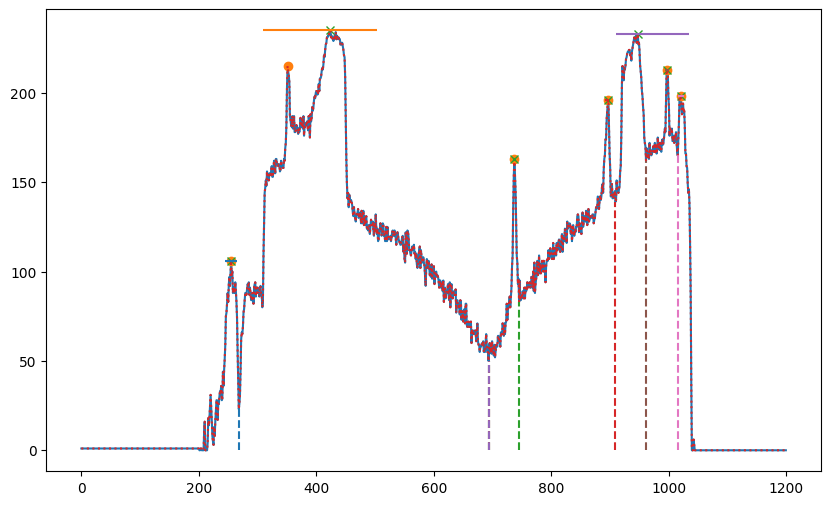

In [84]:
horizontal_cross_section = gray_image[random_y,:].copy()
vertical_cross_Section = gray_image[:,random_x].copy()


fig, ax = plt.subplots(figsize=(10, 6))


vertical_cross_Section[:Vertical_limits[0]]=vertical_cross_Section[Vertical_limits[0]]
vertical_cross_Section[Vertical_limits[1]:]=vertical_cross_Section[Vertical_limits[1]]

vertical_cross_Section = np.max(vertical_cross_Section) - vertical_cross_Section




ax.plot(vertical_cross_Section)

data = scipy.signal.savgol_filter(vertical_cross_Section, window_length=5, polyorder=4)



sharp_peaks, sharp_peaks_properties = scipy.signal.find_peaks(data, 
                                                              height=100, 
                                                              distance=20, 
                                                              prominence=25,
                                                              width=[1,30])

ax.plot(sharp_peaks, data[sharp_peaks], "o")


#basic peak fitting 

peaks, properties = scipy.signal.find_peaks(data, height=10, distance=20, prominence=15, width=5)
print(f"Found peaks at: {peaks}")

print("Peak properties:")
for key in properties.keys():
    print(f"  {key}: {properties[key]}")
ax.plot(peaks, data[peaks], "x")
ax.plot(data,':')
colors = ['C0', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15']
i=0
#could this peak be a plateu?
for peak in peaks:
    left_ips = int(properties['left_ips'][np.where(peaks == peak)][0])
    right_ips = int(properties['right_ips'][np.where(peaks == peak)][0])
    width = right_ips - left_ips
    print(f"Peak at {peak} has width {width} (left_ips: {left_ips}, right_ips: {right_ips})")
    ax.hlines(y=data[peak], xmin=left_ips, xmax=right_ips, color=colors[i])
    #ax.hlines(y=data[left_ips], xmin=left_ips-5, xmax=left_ips, color='C2')
    #ax.hlines(y=data[right_ips], xmin=right_ips, xmax=right_ips+5, color='C2')

    # Draw vertical lines at the left and right bases
    left_base = int(properties['left_bases'][np.where(peaks == peak)][0])
    right_base = int(properties['right_bases'][np.where(peaks == peak)][0])  
    ax.vlines(x=left_base, ymin=0, ymax=data[left_base], color=colors[i], linestyle='--')
    ax.vlines(x=right_base, ymin=0, ymax=data[right_base], color=colors[i], linestyle='--')
    i+=1

In [80]:
import findpeaks

[23-09-2025 11:13:17] [findpeaks.stats] [INFO] Detect peaks using topology method with limit at 20.
[23-09-2025 11:13:17] [findpeaks.stats] [DEBUG] Making values unique
[23-09-2025 11:13:18] [findpeaks.stats] [INFO] Topology
1624it [00:00, 81809.61it/s]


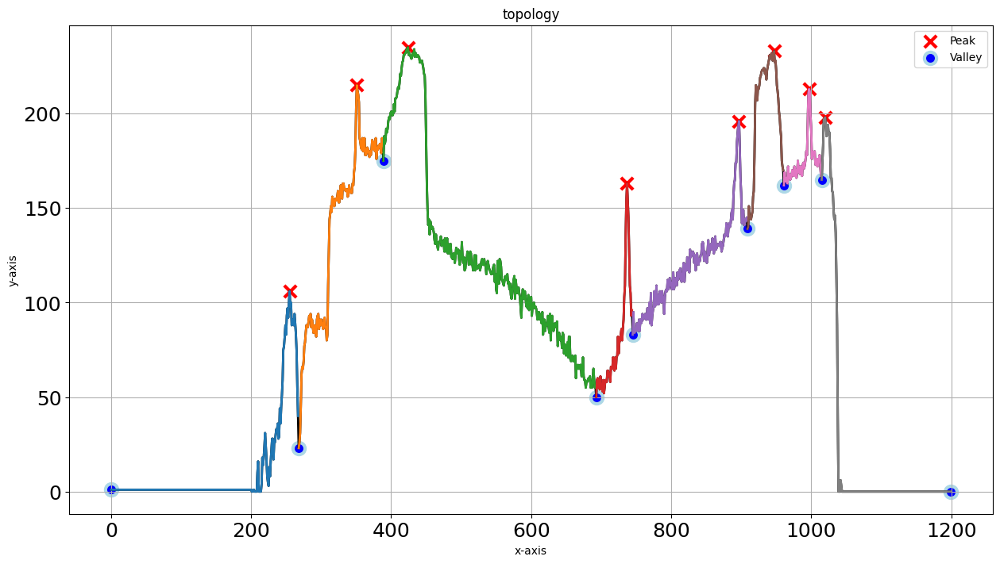

[23-09-2025 11:13:18] [findpeaks.findpeaks] [INFO] Plotting persistence axis 2
100%|██████████| 8/8 [00:00<00:00, 3927.25it/s]
[23-09-2025 11:13:18] [findpeaks.findpeaks] [INFO] Plotting persistence axis 1
100%|██████████| 8/8 [00:00<00:00, 2723.57it/s]


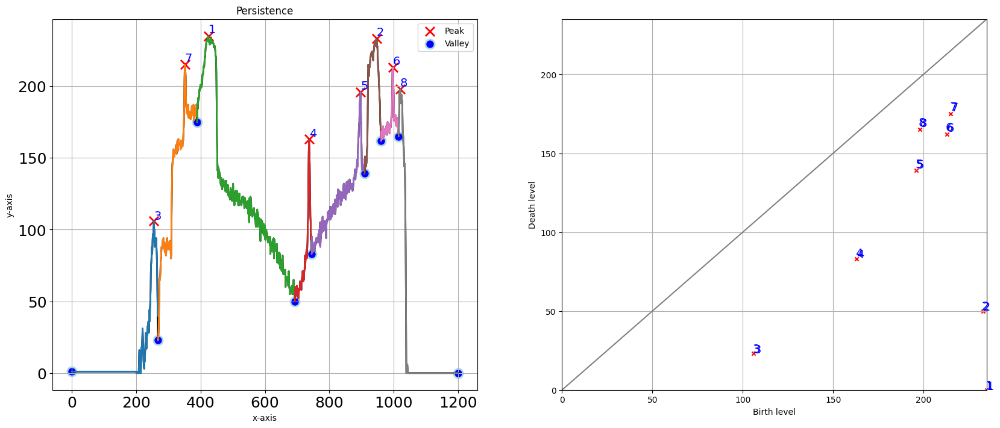

(<Axes: title={'center': 'Persistence'}, xlabel='x-axis', ylabel='y-axis'>,
 <Axes: xlabel='Birth level', ylabel='Death level'>)

In [86]:
fp = findpeaks.findpeaks(method='topology',limit=20)



# Peak detection
results = fp.fit(data)

# Plot results
fp.plot()

# Plot persistence diagram
fp.plot_persistence()